# The Relationship between Welfare Metrics of US States and Counties on the Severity of COVID-19

# Project 1

## Introduction

COVID-19 has been treated as a cause of welfare distortions across the past few years having disrupted the global economy and every individual's lifestyle. Having affected minorities and vulnerable demographics the most severely. However consider the severity of COVID-19 as reliant on how good or bad one's quality of life may be (Razieh et al.). In this case welfare metrics and their indication of a quality of life is treated as the primary cause as to how detrimental COVID has become. Hence the accelerated transmission of COVID from epidemic to pandemic may have been due to poor cases of welfare that spurred on the survival of the virus.

As such the focus of this paper is to assess how correlated welfare metrics are in transgressing the severity of COVID-19 in US counties and states. For this, welfare metrics is to be defined as a measure of wellbeing and "better life" indicators (Vogliano, Maxwell). Thus this paper quantifies an array of variables that have implicit and explicit effects on quality of life and assess whether certain conditions have propogated a worsening of COVID-19's impact.

The source of data is from FiveThirtyEight, an online opinion and analysis pollster, with the data on county results for 2020 and 2016 US Presidential polls, demographic makeup, employment type and level, and income and poverty levels. The dataset for crime was obtained from Campaign Zero, a police reform organization. 

Initial findings through simple regression analysis indicates weak to no correlation across the board, however through comparisons with several COVID metrics and state and county level some correlation is suggested. Moreover, the introduction of mapping allowed for another consideration being geographical area as a factor, this plays into the urban density as well as global significance such as trade and tourism playing into the welfare metrics affecting COVID severity.


## Data cleaning and Loading

In [3]:
! pip install qeds fiona geopandas xgboost gensim folium pyLDAvis descartes

import pandas as pd
%matplotlib inline
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns
import plotly.express as px
from plotly.offline import init_notebook_mode
init_notebook_mode(connected=True)
from plotly.subplots import make_subplots
import plotly.graph_objects as go
from IPython.display import display
import geopandas as gpd
from shapely.geometry import Point
import qeds


In [4]:
county_stats = pd.read_csv(r'/Users/adieaimannazrinnoornazri/ECO225/Project Data/county_statistics.csv')

Comparing the non-null and null values, we see that there is a maximum of 1756 null value rows present in the dataset.

In [5]:
county_stats.isnull().sum()

Unnamed: 0                         0
county                             0
state                              0
percentage16_Donald_Trump       1756
percentage16_Hillary_Clinton    1756
total_votes16                   1756
votes16_Donald_Trump            1756
votes16_Hillary_Clinton         1756
percentage20_Donald_Trump        377
percentage20_Joe_Biden           377
total_votes20                    234
votes20_Donald_Trump             234
votes20_Joe_Biden                234
lat                             1615
long                            1615
cases                           1615
deaths                          1615
TotalPop                        1725
Men                             1725
Women                           1725
Hispanic                        1725
White                           1725
Black                           1725
Native                          1725
Asian                           1725
Pacific                         1725
VotingAgeCitizen                1725
I

As some counties have no voting statistics meaning we are unable to know which political party won, we will be entirely dropping these rows. This will cause gaps in mapping the contiguous USA when going by county, however due to lack of data which can result in coding errors it is necessary to remove them.

In [6]:
county_stats.dropna(inplace=True, axis=0)
county_stats.head()

,Unnamed: 0,county,state,percentage16_Donald_Trump,percentage16_Hillary_Clinton,total_votes16,votes16_Donald_Trump,votes16_Hillary_Clinton,percentage20_Donald_Trump,percentage20_Joe_Biden,...,Walk,OtherTransp,WorkAtHome,MeanCommute,Employed,PrivateWork,PublicWork,SelfEmployed,FamilyWork,Unemployment
0,0,Abbeville,SC,0.629,0.346,10724.0,6742.0,3712.0,0.661,0.330,...,1.8,1.8,6.5,25.8,9505.0,78.8,13.3,7.8,0.1,9.4
1,1,Acadia,LA,0.773,0.206,27386.0,21159.0,5638.0,0.795,0.191,...,1.6,2.2,2.5,27.6,24982.0,80.0,12.1,7.6,0.3,8.9
2,2,Accomack,VA,0.545,0.428,15755.0,8582.0,6737.0,0.542,0.447,...,2.6,1.8,4.5,22.0,13837.0,74.6,18.1,7.1,0.2,5.4
3,3,Ada,ID,0.479,0.387,195587.0,93748.0,75676.0,0.504,0.465,...,1.5,2.8,6.9,20.4,214984.0,78.3,15.0,6.6,0.1,4.3
4,4,Adair,IA,0.653,0.300,3759.0,2456.0,1127.0,0.697,0.286,...,2.8,0.4,6.2,22.3,3680.0,73.8,15.3,10.4,0.5,3.0


In [7]:
county_stats.isnull().sum()

Unnamed: 0                      0
county                          0
state                           0
percentage16_Donald_Trump       0
percentage16_Hillary_Clinton    0
total_votes16                   0
votes16_Donald_Trump            0
votes16_Hillary_Clinton         0
percentage20_Donald_Trump       0
percentage20_Joe_Biden          0
total_votes20                   0
votes20_Donald_Trump            0
votes20_Joe_Biden               0
lat                             0
long                            0
cases                           0
deaths                          0
TotalPop                        0
Men                             0
Women                           0
Hispanic                        0
White                           0
Black                           0
Native                          0
Asian                           0
Pacific                         0
VotingAgeCitizen                0
Income                          0
IncomeErr                       0
IncomePerCap  

Now all counties with missing datapoints have been removed. This was necessary as we want to find exactly how many counties voted Democratic or Republican, one of the key independent variables we will consider.

For ease of dealing with the datapoints, the table will order datapoints for each state proceeding one another rather than separated.

In [8]:
county_stats = county_stats.sort_values(['state','county'], ascending = [True, True])

For some columns we will convert the datapoints into percentages to see the change over time. This is necessary as we would like to see how any change over time in political leaning has an impact on COVID-19 cases.

In this following function, new columns were created for the relevant values needed. One of these being which party each county voted for in 2020 and 2016. Additionally a vote swing column will be added to see whether the vote switched parties.

In [9]:
def percentages(county_stats):
    county_stats["% \u0394 in Total Votes"] = ((county_stats['total_votes20'] - county_stats['total_votes16'])/county_stats['total_votes16'])*100
    county_stats["% \u0394 in Rep. Votes"] = county_stats["percentage20_Donald_Trump"] - county_stats["percentage16_Donald_Trump"]
    county_stats["% \u0394 in Dem. Votes"] = county_stats['percentage20_Joe_Biden'] - county_stats['percentage16_Hillary_Clinton']
    county_stats["percentage20_Donald_Trump"] = county_stats["percentage20_Donald_Trump"] * 100
    county_stats["percentage16_Donald_Trump"] = county_stats["percentage16_Donald_Trump"] * 100
    county_stats['percentage16_Hillary_Clinton'] = county_stats['percentage16_Hillary_Clinton'] * 100
    county_stats['percentage20_Joe_Biden'] = county_stats['percentage20_Joe_Biden'] * 100
    county_stats['COVID Cases per Capita'] = county_stats['cases'] / county_stats['TotalPop']
    county_stats['Employment Rate'] = 100 - county_stats['Unemployment'] 
    county_stats['Elected 2016'] = np.where(county_stats['percentage16_Donald_Trump'] > county_stats['percentage16_Hillary_Clinton'], 'Republican', 'Democrat')
    county_stats['Elected 2020'] = np.where(county_stats['percentage20_Donald_Trump'] > county_stats['percentage20_Joe_Biden'], 'Republican', 'Democrat')  
    county_stats['Vote Swing'] = np.where(county_stats['Elected 2016'] != county_stats['Elected 2020'], 'Yes', 'No')
    county_stats['COVID Death Rates'] = county_stats['deaths'] / county_stats['cases']
    county_stats['Majority Race'] = county_stats[['Hispanic', 'White', 'Black', 'Native', 'Asian', 'Pacific']].idxmax(axis=1)
    county_stats['Minority Race'] = county_stats[['Hispanic', 'White', 'Black', 'Native', 'Asian', 'Pacific']].idxmin(axis=1)
percentages(county_stats)

This following line creates a new dataframe selecting only the relevant columns from the original data frame. In addition some columns were renamed in order for better clarity and presentation.

In [10]:
county_new = county_stats[['county', 'state','lat','long','total_votes16', 'votes16_Donald_Trump', 'votes16_Hillary_Clinton', 'total_votes20', 
                           'votes20_Donald_Trump', 'votes20_Joe_Biden',
                           '% \u0394 in Total Votes','% \u0394 in Rep. Votes', '% \u0394 in Dem. Votes', 'percentage20_Joe_Biden', 
                           'percentage16_Hillary_Clinton', "percentage20_Donald_Trump","percentage16_Donald_Trump",'Elected 2016', 'Elected 2020'
                          ,'cases', 'deaths', 'COVID Cases per Capita', 'COVID Death Rates', 'Vote Swing', 'Employment Rate', 'Unemployment',
                          'TotalPop','Men','Women', 'Income','IncomeErr','IncomePerCap','IncomePerCapErr','Poverty','Professional',
                           'Service','Office','Construction','Production', 'PrivateWork','PublicWork','SelfEmployed','FamilyWork', 
                           'Hispanic','White','Black','Native','Asian','Pacific','Majority Race','Minority Race']].copy()
county_new = county_new.rename(columns={'total_votes16': '2016 Total Votes'})
county_new = county_new.rename(columns={'votes16_Donald_Trump': '2016 Total Republican Votes'})
county_new = county_new.rename(columns={'votes16_Hillary_Clinton': '2016 Total Democratic Votes'})
county_new = county_new.rename(columns={'total_votes20': '2020 Total Votes'})
county_new = county_new.rename(columns={'votes20_Donald_Trump': '2020 Total Republican Votes'})
county_new = county_new.rename(columns={'votes20_Joe_Biden': '2020 Total Democratic Votes'})

county_new = county_new.rename(columns={'percentage20_Joe_Biden': '2020 Democrat Vote Share %'})
county_new = county_new.rename(columns={'percentage16_Hillary_Clinton': '2016 Democrat Vote Share %'})
county_new = county_new.rename(columns={'percentage20_Donald_Trump': '2020 Republican Vote Share %'})
county_new = county_new.rename(columns={'percentage16_Donald_Trump': '2016 Republican Vote Share %'})

county_new = county_new.rename(columns={"Unemployment": 'Unemployment Rate'})
county_new = county_new.rename(columns={"Office": '% in Office Work'})
county_new = county_new.rename(columns={"Service": '% in Service Work'})
county_new = county_new.rename(columns={"Production": '% in Production Work'})
county_new = county_new.rename(columns={"Construction": '% in Construction'})
county_new = county_new.rename(columns={"Professional": '% in Professional Work'})
county_new = county_new.rename(columns={"PrivateWork": '% in Private Work'})
county_new = county_new.rename(columns={"PublicWork": '% in Public Work'})
county_new = county_new.rename(columns={"SelfEmployed": '% in Self Employed'})
county_new = county_new.rename(columns={"FamilyWork": '% in Family Work'})
county_new = county_new.rename(columns={"IncomePerCap": 'Income Per Capita'})
county_new = county_new.rename(columns={"Poverty": 'Poverty Rate'})
county_new = county_new.rename(columns={"county": 'County'})
county_new = county_new.rename(columns={"cases": 'COVID Cases'})
county_new = county_new.rename(columns={"deaths": 'COVID Deaths'})
county_new = county_new.rename(columns={"state": 'State'})
county_new.reset_index(drop=True, inplace=True)
county_new

,County,State,lat,long,2016 Total Votes,2016 Total Republican Votes,2016 Total Democratic Votes,2020 Total Votes,2020 Total Republican Votes,2020 Total Democratic Votes,...,% in Self Employed,% in Family Work,Hispanic,White,Black,Native,Asian,Pacific,Majority Race,Minority Race
0,Autauga,AL,32.539527,-86.644082,24661.0,18110.0,5908.0,27639.0,19764.0,7450.0,...,5.6,0.1,2.7,75.4,18.9,0.3,0.9,0.0,White,Pacific
1,Baldwin,AL,30.727750,-87.722071,94090.0,72780.0,18409.0,108945.0,83055.0,24344.0,...,6.3,0.1,4.4,83.1,9.5,0.8,0.7,0.0,White,Pacific
2,Barbour,AL,31.868263,-85.387129,10390.0,5431.0,4848.0,10457.0,5605.0,4772.0,...,6.5,0.3,4.2,45.7,47.8,0.2,0.6,0.0,Black,Pacific
3,Bibb,AL,32.996421,-87.125115,8748.0,6733.0,1874.0,9573.0,7508.0,1982.0,...,6.3,0.3,2.4,74.6,22.0,0.4,0.0,0.0,White,Asian
4,Blount,AL,33.982109,-86.567906,25384.0,22808.0,2150.0,27459.0,24595.0,2627.0,...,4.0,0.1,9.0,87.4,1.5,0.3,0.1,0.0,White,Pacific
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3041,Sweetwater,WY,41.659439,-108.882788,16661.0,12153.0,3233.0,16603.0,12229.0,3823.0,...,3.8,0.0,16.0,79.6,0.8,0.6,0.6,0.5,White,Pacific
3042,Teton,WY,43.935225,-110.589080,12176.0,3920.0,7313.0,14677.0,4341.0,9848.0,...,6.5,0.0,15.0,81.5,0.5,0.3,2.2,0.0,White,Pacific
3043,Uinta,WY,41.287818,-110.547578,8053.0,6154.0,1202.0,9402.0,7496.0,1591.0,...,6.6,0.4,9.1,87.7,0.1,0.9,0.1,0.0,White,Pacific
3044,Washakie,WY,43.904516,-107.680187,3715.0,2911.0,532.0,4012.0,3245.0,651.0,...,8.1,0.2,14.2,82.2,0.3,0.4,0.1,0.0,White,Pacific


Another dataframe will be created only with state results, this will mean averaging out all the values of the counties corresponding to a certain state and displaying only that averaged value for each column.

However for the the 2016 and 2020 vote shares for each political party as well as population and COVID statistics, the mean was not used as it would skew the data and cause it to be unreliable. Hence, instead this was calculated through summing the total number of overall votes, democratic votes, republican votes, COVID and population data seperately. This is seen in the respective 2016, 2020, democrat, republican and total votes columns. From this only then were the vote shares calculated.

Additionally a vote swing column was added using the calculated total votes for each party in order to determine whether the state switched political affiliation between 2016 and 2020.

We will use this to be able to plot graphs that use only state data.

In [11]:
states_only_votes_pop = county_new[['State', '2016 Total Votes',
       '2016 Total Republican Votes', '2016 Total Democratic Votes',
       '2020 Total Votes', '2020 Total Republican Votes',
       '2020 Total Democratic Votes', 'TotalPop', 'Men', 'Women','COVID Cases','COVID Deaths']].copy()
#states_only_votes_pop
states_only_votes_pop = states_only_votes_pop.groupby('State').sum().apply(list).reset_index()
states_only_votes_pop

,State,2016 Total Votes,2016 Total Republican Votes,2016 Total Democratic Votes,2020 Total Votes,2020 Total Republican Votes,2020 Total Democratic Votes,TotalPop,Men,Women,COVID Cases,COVID Deaths
0,AL,2078165.0,1306925.0,718084.0,2309900.0,1434159.0,843473.0,4850771.0,2350806.0,2499965.0,193985.0,2973.0
1,AR,1121684.0,677904.0,378729.0,1209372.0,757052.0,418051.0,2977944.0,1461651.0,1516293.0,111417.0,1958.0
2,AZ,2062810.0,1021154.0,936250.0,3366867.0,1651812.0,1663447.0,6809946.0,3385055.0,3424891.0,247473.0,5978.0
3,CA,9631972.0,3184721.0,5931283.0,16092730.0,5416035.0,10339137.0,38982847.0,19366579.0,19616268.0,935878.0,17671.0
4,CO,2564185.0,1137455.0,1212209.0,3216881.0,1347516.0,1783149.0,5436519.0,2731315.0,2705204.0,109887.0,2288.0
5,CT,1535140.0,629419.0,839126.0,142272.0,33714.0,106730.0,3430368.0,1673819.0,1756549.0,69048.0,4419.0
6,DC,280272.0,11553.0,260223.0,37762.0,1506.0,35485.0,672391.0,319046.0,353345.0,17369.0,646.0
7,DE,441535.0,185103.0,235581.0,504010.0,200603.0,296268.0,943732.0,456876.0,486856.0,25035.0,710.0
8,FL,9386750.0,4605515.0,4485745.0,11075446.0,5667474.0,5294767.0,20278447.0,9914361.0,10364086.0,805487.0,16789.0
9,GA,4029564.0,2068623.0,1837300.0,4992420.0,2457924.0,2471981.0,10201635.0,4968887.0,5232748.0,344965.0,7786.0


In [12]:
states_only_no_pop = county_new[['County', 'State', 'lat', 'long', 'Elected 2016', 'Elected 2020',
       'Vote Swing', 'Employment Rate',
       'Unemployment Rate', 'Income', 'IncomeErr',
       'Income Per Capita', 'IncomePerCapErr', 'Poverty Rate',
       '% in Professional Work', '% in Service Work', '% in Office Work',
       '% in Construction', '% in Production Work', '% in Private Work',
       '% in Public Work', '% in Self Employed', '% in Family Work',
       'Hispanic', 'White', 'Black', 'Native', 'Asian', 'Pacific',
       'Majority Race', 'Minority Race']].copy()

#states_only.drop(['2020 Democrat Vote Share %', '2016 Democrat Vote Share %', '2020 Republican Vote Share %', '2016 Republican Vote Share %'], axis = 1, inplace=True)

states_only = states_only_no_pop.merge(states_only_votes_pop, on="State", how="inner")

states_only = states_only.groupby('State').mean().apply(list).reset_index()

states_only['2020 Democrat Vote Share %'] = states_only['2020 Total Democratic Votes'] / states_only['2020 Total Votes'] * 100
states_only['2016 Democrat Vote Share %'] = states_only['2016 Total Democratic Votes'] / states_only['2016 Total Votes'] * 100
states_only['2020 Republican Vote Share %'] = states_only['2020 Total Republican Votes'] / states_only['2020 Total Votes'] * 100
states_only['2016 Republican Vote Share %'] = states_only['2016 Total Republican Votes'] / states_only['2020 Total Votes'] * 100
states_only["% \u0394 in Total Votes"] = ((states_only['2020 Total Votes'] - states_only['2016 Total Votes'])/states_only['2016 Total Votes'])*100
states_only["% \u0394 in Rep. Votes"] = ((states_only['2020 Total Republican Votes'] - states_only['2016 Total Republican Votes'])/states_only['2016 Total Republican Votes'])*100
states_only["% \u0394 in Dem. Votes"] = ((states_only['2020 Total Democratic Votes'] - states_only['2016 Total Democratic Votes'])/states_only['2016 Total Democratic Votes'])*100
states_only['Elected 2016'] = np.where(states_only['2016 Total Republican Votes'] > states_only['2016 Total Democratic Votes'], 'Republican', 'Democrat')
states_only['Elected 2020'] = np.where(states_only['2020 Total Republican Votes'] > states_only['2020 Total Democratic Votes'], 'Republican', 'Democrat')  
states_only['Vote Swing'] = np.where(states_only['Elected 2016'] != states_only['Elected 2020'], 'Yes', 'No')
states_only['Asian Population'] = states_only['TotalPop'] * (states_only['Asian']/100)
states_only['Hispanic Population'] = states_only['TotalPop'] * (states_only['Hispanic']/100)
states_only['White Population'] = states_only['TotalPop'] * (states_only['White']/100)
states_only['Black Population'] = states_only['TotalPop'] * (states_only['Black']/100)
states_only['Native Population'] = states_only['TotalPop'] * (states_only['Native']/100)
states_only['Pacific Population'] = states_only['TotalPop'] * (states_only['Pacific']/100)
states_only['Majority Race'] = states_only[['Hispanic', 'White', 'Black', 'Native', 'Asian', 'Pacific']].idxmax(axis=1)
states_only['Minority Race'] = states_only[['Hispanic', 'White', 'Black', 'Native', 'Asian', 'Pacific']].idxmin(axis=1)
states_only['COVID Cases per Capita'] = states_only['COVID Cases']/states_only['TotalPop']
states_only['COVID Death Rates'] = states_only['COVID Deaths']/states_only['TotalPop']

#states_only.keys()
states_only.head()
#states_only.loc[:,["State","COVID Death Rates"]]

,State,lat,long,Employment Rate,Unemployment Rate,Income,IncomeErr,Income Per Capita,IncomePerCapErr,Poverty Rate,...,Asian Population,Hispanic Population,White Population,Black Population,Native Population,Pacific Population,Majority Race,Minority Race,COVID Cases per Capita,COVID Death Rates
0,AL,32.884280,-86.710122,90.976119,9.023881,40271.402985,2513.194030,22180.492537,1195.343284,20.949254,...,3.453459e+04,1.600030e+05,3.161182e+06,1.390868e+06,29466.623836,868.794806,White,Pacific,0.039991,0.000613
1,AR,34.911889,-92.433978,92.708000,7.292000,39025.080000,2859.333333,21449.306667,1437.586667,20.421333,...,2.060737e+04,1.515972e+05,2.252358e+06,4.804019e+05,16080.897600,2302.943360,White,Pacific,0.037414,0.000658
2,AZ,33.675904,-111.463232,90.233333,9.766667,45816.666667,2159.933333,22712.200000,805.200000,20.193333,...,8.807530e+04,2.103365e+06,3.461269e+06,1.234870e+05,901182.854000,8625.931600,White,Pacific,0.036340,0.000878
3,CA,37.843962,-120.728594,91.734483,8.265517,61046.758621,2232.396552,30416.482759,1022.120690,15.737931,...,2.756356e+06,1.172241e+07,2.134781e+07,1.147978e+06,643216.975500,113587.950741,White,Pacific,0.024007,0.000453
4,CO,38.935474,-105.486240,94.206250,5.793750,54353.562500,4014.937500,29647.046875,2427.171875,13.234375,...,6.031138e+04,1.089342e+06,4.058786e+06,8.061338e+04,45191.064188,6201.029484,White,Pacific,0.020213,0.000421


## Summary Statistics Tables

Summary statistics  include the:

- Political affiliation (% $\Delta$ in Total Votes, % $\Delta$ in Rep. Votes, % $\Delta$ in Dem. Votes, Vote Swing) 
- Race (Majority and Minority races)
- Employment Type (Professional, Service, Office, Construction, Production, Private Work, Public Work, Self Employed, Family Work)
- Wealth (Income, Income per capita, Poverty Rate)
- Employment Level (Employment rate, Unemploment rate)

Each of these represent an X variable to be analysed with COVID data that includes total, per capita, and death rates. Political affiliation was chosen in order to represent how freedom in choosing a certain candidate or party has implications in the effectiveness of government policy against COVID. Race for the environmental circumstances individuals face that can lead to certain lifelong implications (Razieh et al.). Employment type for the risk in being exposed to COVID in certain physical environments. Wealth for the measure of access to quality infrastructure that can be critical to avoiding or combatting COVID (OECD). Finally employment level also for risk to certain environments and lack of access to life critical resources.

This will be seperated into two types of summary statistics, numerical and categorical.

### Numerical Summary Statistics:

- Covid Data
- Employment Type
- Wealth Level
- Employment Level

### Covid Data Summary Statistics (Counties)

In [13]:
covid_sum_stats = county_new[['COVID Cases','COVID Deaths','COVID Cases per Capita','COVID Death Rates']].describe()
covid_sum_stats.drop('count', inplace=True)
covid_sum_stats.loc["range"] = covid_sum_stats.loc['max'] - covid_sum_stats.loc['min']
covid_sum_stats.round(decimals=2)

,COVID Cases,COVID Deaths,COVID Cases per Capita,COVID Death Rates
mean,2902.46,72.73,0.03,0.02
std,10817.51,342.06,0.02,0.02
min,0.00,0.00,0.00,0.00
25%,241.25,3.00,0.02,0.01
50%,654.50,11.00,0.03,0.02
75%,1794.75,36.00,0.04,0.03
max,309190.00,7404.00,0.20,0.20
range,309190.00,7404.00,0.20,0.20


### Covid Data Summary Statistics (States)

In [14]:
state_covid_sum_stats = states_only[['COVID Cases','COVID Deaths','COVID Cases per Capita','COVID Death Rates']].describe()
state_covid_sum_stats.drop('count', inplace=True)
state_covid_sum_stats.loc["range"] = state_covid_sum_stats.loc['max'] - state_covid_sum_stats.loc['min']
state_covid_sum_stats['COVID Death Rates'].round(decimals=10)
state_covid_sum_stats

,COVID Cases,COVID Deaths,COVID Cases per Capita,COVID Death Rates
mean,176817.900000,4430.900000,0.028265,0.000626
std,212054.648696,6284.342601,0.011501,0.000397
min,2037.000000,57.000000,0.003759,0.000105
25%,45640.000000,663.250000,0.020674,0.000358
50%,115958.500000,2325.500000,0.027528,0.000507
75%,209308.250000,5082.000000,0.036370,0.000763
max,936816.000000,33514.000000,0.060422,0.001825
range,934779.000000,33457.000000,0.056663,0.001720


For the COVID data  for both **counties** and **states**, the metrics considered were the number of cases, number of deaths, cases per capita and death rates.

Differences are in the mean in that the **states** had a higher mean for COVID cases and COVID death than **counties**.

### COVID Cases:
The distribution of **COVID Cases** is **not symmetric** as the quartiles are **not uniformly** distributed from the median. This is characterized by a very **high** standard deviation and **high** range that indicates a great spread and variation in data. The data is **negative** or **left** skewed.

Additionally the mean and median are **far apart** thus COVID Cases has an **asymmetric distribution**

### COVID Deaths:
The distribution of **COVID Deaths** is **not symmetric** as the quartiles are **not uniformly** distributed from the median. This is characterized by a very **high** standard deviation and **high** range that indicates a great spread and variation in data. The data is **negative** or **left** skewed.

Additionally the mean and median are **far apart** thus COVID Cases has an **asymmetric distribution**

### COVID Cases per Capita:
The distribution of **COVID Cases per Capita** is **fairly symmetric** as the quartiles are **uniformly** distributed from the median. This is characterized by a **low** standard deviation and **low** range that indicates a low spread and variation in data. The data is **symmetric** or **not** skewed.

Additionally the mean and median are **equal** thus COVID Cases has an **symmetric distribution**

### COVID Death Rates:
The distribution of **COVID Death Rates** is **fairly symmetric** as the quartiles are **uniformly** distributed from the median. This is characterized by a **low** standard deviation and **low** range that indicates a low spread and variation in data. The data is **symmetric** or **not** skewed.

Additionally the mean and median are **equal** thus COVID Cases has an **symmetric distribution**. 


### Overview


An **asymmetric distribution** as such will affect the data analysis in that it will be sensitive to any outliers due to non-uniformed spread of the data. Hence, it may see that a weaker correlation between the independent and dependent variables and potentially may not indicate that the welfare metrics used indicate any influence in COVID severity.

A **symmetric distribution** is optimal for data analysis as it will not be as sensitive to outliers due to the nature of the relationship between the datapoints. Hence, it will allow for stronger correlation as outliers do not affect regression and may allow for better indication that the welfare metrics used indicate any influence in COVID severity.

### Employment Type Summary Statistics

In [15]:
employment_sum_stats = county_new[['% in Professional Work',
                           '% in Service Work','% in Office Work','% in Construction','% in Production Work', '% in Private Work','% in Public Work','% in Self Employed','% in Family Work'] ].describe()
employment_sum_stats.loc["range"] = employment_sum_stats.loc['max'] - employment_sum_stats.loc['min']
employment_sum_stats.drop('count', inplace=True)
employment_sum_stats.round(decimals=2)

,% in Professional Work,% in Service Work,% in Office Work,% in Construction,% in Production Work,% in Private Work,% in Public Work,% in Self Employed,% in Family Work
mean,31.42,18.08,21.77,12.70,16.03,75.22,16.69,7.81,0.28
std,6.43,3.66,3.03,4.12,5.77,7.33,5.91,3.87,0.45
min,11.40,0.00,4.80,2.20,0.00,32.10,4.40,0.00,0.00
25%,27.20,15.70,19.82,9.90,11.80,71.80,12.60,5.30,0.10
50%,30.50,17.70,22.00,12.20,15.70,76.40,15.60,6.80,0.20
75%,34.80,20.00,23.80,14.90,19.70,80.30,19.30,9.20,0.30
max,69.00,46.40,37.20,36.40,48.70,88.80,62.30,38.00,8.00
range,57.60,46.40,32.40,34.20,48.70,56.70,57.90,38.00,8.00



In the Employment Type variable, all 3 types of skewedness exists. Office, Private, and Public are all **right** and **positively** skewed, whereas Professional, Service, Construction, Production and Self Employed are **left** and **negatively** skewed. The direction of skewedness depends on which of the differences between the middle and lower or upper and middle quartile is greater. Regardless they all have **asymmetric** distribution. For Family Work, despite the differences between the quartiles being equal, there is skewedness to the **right** as the mean is greater than the median. However as its range and standard deviation is low, the distribution isn't as spread out.

A **symmetric distribution** is optimal for data analysis as it will not be as sensitive to outliers due to the nature of the relationship between the datapoints. Hence, it will allow for stronger correlation as outliers do not affect regression and may allow for better indication that the welfare metrics used indicate any influence in COVID severity.

### Wealth Level Summary Statistics

In [16]:
wealth_sum_stats = county_new[['Income', 'Income Per Capita','Poverty Rate']].describe()
wealth_sum_stats.drop('count', inplace=True)
wealth_sum_stats.loc["range"] = wealth_sum_stats.loc['max'] - wealth_sum_stats.loc['min']
wealth_sum_stats.round(decimals=2)

,Income,Income Per Capita,Poverty Rate
mean,49507.42,25914.91,15.99
std,12867.22,6115.95,6.50
min,19264.00,10960.00,2.40
25%,41115.00,21782.00,11.40
50%,47938.00,25211.00,15.20
75%,55433.25,28940.75,19.30
max,129588.00,69529.00,52.00
range,110324.00,58569.00,49.60



For the wealth level statistics, all the metrics are **left** and **negatively** skewed. Though we can consider the variation of how **asymmetric** their distributions are respectively by considering their standard deviations. For this Income, then Income per Capita and finally Poverty Rate would follow in terms of how great the spread of data is. This too is confirmed by looking at the range where they also descend in the same order. Hence while none are **uniformly** distributed they vary in the **skewedness**.

An **asymmetric distribution** as such will affect the data analysis in that it will be sensitive to any outliers due to non-uniformed spread of the data. Hence, it may see that a weaker correlation between the independent and dependent variables and potentially may not indicate that the welfare metrics used indicate any influence in COVID severity.


### Employment Level Summary Statistics

In [17]:
employment_level_sum_stats = county_new[['Employment Rate', 'Unemployment Rate']].describe()
employment_level_sum_stats.drop('count', inplace=True)
employment_level_sum_stats.loc["range"] = employment_level_sum_stats.loc['max'] - employment_level_sum_stats.loc['min']
employment_level_sum_stats.round(decimals=2)

,Employment Rate,Unemployment Rate
mean,93.68,6.32
std,2.97,2.97
min,71.30,0.00
25%,92.20,4.40
50%,94.00,6.00
75%,95.60,7.80
max,100.00,28.70
range,28.70,28.70


The employment rate is **right** or **positively** skewed despite the standard deviation being **low**, the mean and median are **not equal** hence there is an **asymmentric** distribution. However as the range is **not too high** the spread of data isn't too great.

The unemployment rate is **left** or **negatively** skewed despite the standard deviation being **low**, the mean and median are **not equal** hence there is an **asymmentric** distribution. However as the range is **not too high** the spread of data isn't too great.

An **asymmetric distribution** as such will affect the data analysis in that it will be sensitive to any outliers due to non-uniformed spread of the data. Hence, it may see that a weaker correlation between the independent and dependent variables and potentially may not indicate that the welfare metrics used indicate any influence in COVID severity.


### Cateogorical Summary Statistics:

- Political Affiliation
- Race

Dealing with categorical statistics such as the vote swing which is a Yes or No query, we will use dummy variables to be able to computate it quantitatively into a summary statistics table.

The entirety of the tables are not all categorical with some numerical statistics included as well.

### Political Affiliation Summary Statistics

In [18]:
county_new_dum = pd.get_dummies(county_new, columns=['Vote Swing', 'Majority Race', 'Minority Race'])
county_new_dum.columns = county_new_dum.columns.str.replace('_', ' ')

political_sum_stats = county_new_dum[['% \u0394 in Total Votes', '% \u0394 in Rep. Votes','% \u0394 in Dem. Votes','Vote Swing No', 'Vote Swing Yes', '2020 Democrat Vote Share %', '2016 Democrat Vote Share %', '2020 Republican Vote Share %', '2016 Republican Vote Share %'] ].describe()
political_sum_stats.drop('count', inplace=True)
political_sum_stats.loc["range"] = political_sum_stats.loc['max'] - political_sum_stats.loc['min']
political_sum_stats.round(decimals=2)

,% Δ in Total Votes,% Δ in Rep. Votes,% Δ in Dem. Votes,Vote Swing No,Vote Swing Yes,2020 Democrat Vote Share %,2016 Democrat Vote Share %,2020 Republican Vote Share %,2016 Republican Vote Share %
mean,12.61,0.02,0.01,0.97,0.03,32.62,31.23,65.65,64.09
std,20.90,0.03,0.03,0.16,0.16,15.51,14.97,15.63,15.24
min,-99.34,-0.30,-0.27,0.00,0.00,3.10,3.10,4.00,4.10
25%,6.34,0.00,-0.00,1.00,0.00,20.80,20.30,56.80,55.70
50%,11.48,0.01,0.01,1.00,0.00,29.55,28.20,68.80,67.00
75%,17.45,0.03,0.03,1.00,0.00,41.58,39.30,77.60,75.20
max,396.78,0.28,0.34,1.00,1.00,94.00,92.80,96.20,95.30
range,496.12,0.58,0.60,1.00,1.00,90.90,89.70,92.20,91.20


In [19]:
states_only_dum = pd.get_dummies(states_only, columns=['Vote Swing', 'Majority Race', 'Minority Race'])
states_only_dum.columns = states_only_dum.columns.str.replace('_', ' ')

states_sum_political = states_only_dum[['% \u0394 in Total Votes', '% \u0394 in Rep. Votes','% \u0394 in Dem. Votes','Vote Swing No', 'Vote Swing Yes', '2020 Democrat Vote Share %', '2016 Democrat Vote Share %', '2020 Republican Vote Share %', '2016 Republican Vote Share %']].describe()
states_sum_political.drop('count', inplace=True)
states_sum_political

,% Δ in Total Votes,% Δ in Rep. Votes,% Δ in Dem. Votes,Vote Swing No,Vote Swing Yes,2020 Democrat Vote Share %,2016 Democrat Vote Share %,2020 Republican Vote Share %,2016 Republican Vote Share %
mean,3.917902,5.462739,13.372686,0.880000,0.120000,49.007298,45.098724,48.933898,96.892100
std,40.387535,43.332721,45.810056,0.328261,0.328261,13.063346,12.478367,12.918800,175.613621
min,-95.012109,-94.997608,-94.583940,0.000000,0.000000,26.553574,22.492784,3.988136,19.789812
25%,7.621445,7.999903,12.908426,1.000000,0.000000,39.216293,35.983908,41.463302,38.114625
50%,12.090930,12.427832,23.005366,1.000000,0.000000,49.430713,46.671531,49.146960,45.488864
75%,20.200754,21.709442,32.567799,1.000000,0.000000,56.300186,52.935689,58.475849,56.267650
max,68.416737,109.943729,128.650191,1.000000,1.000000,93.970129,92.846592,69.936227,860.944959



For the political affiliation metrics, the **left** or **negative** skewed distribution were the % $\Delta$ in Total Votes, Republican Votes, Democratic Votes, and the 2020 and 2016 Democrat Vote Share %. For these the mean and median were **not equal** and the the relative range for all were fairly **high** leading to an **asymmetric** distribution.


However, while Vote Swing No and Yes had the differences between the middle and lower quartiles and the upper and middle quartiles being **equal**; if we consider the mean and medians they are **not equal**. Thus, they cannot be perfectly uniform, rather Vote Swing No has a greater median than mean inferring perhaps it is skewed **left** or **negatively**. Vote Swing Yes is the opposite hence skewing **right** or **positively**.


The final metrics, 2020 and 2016 Republican Vote Share are skewed **right** or **positively** and looking at the mean and median they are **equal** implying **asymmetric** distribution. Moreover, the range for both are **high** hence a greater spread in the data.

An **asymmetric distribution** as such will affect the data analysis in that it will be sensitive to any outliers due to non-uniformed spread of the data. Hence, it may see that a weaker correlation between the independent and dependent variables and potentially may not indicate that the welfare metrics used indicate any influence in COVID severity.


### Race Summary Statistics

In [20]:
race_sum_stats = county_new[['Hispanic','White','Black','Native','Asian','Pacific']].describe()
race_sum_stats.drop('count', inplace=True)
race_sum_stats.loc["range"] = race_sum_stats.loc['max'] - race_sum_stats.loc['min']
race_sum_stats.round(decimals=2)

,Hispanic,White,Black,Native,Asian,Pacific
mean,9.20,77.22,8.80,1.53,1.24,0.07
std,13.83,19.73,14.31,6.28,2.53,0.39
min,0.00,0.60,0.00,0.00,0.00,0.00
25%,2.00,65.70,0.60,0.10,0.30,0.00
50%,3.90,84.50,2.10,0.30,0.60,0.00
75%,9.40,93.00,9.80,0.60,1.20,0.10
max,99.20,100.00,86.90,82.20,41.80,11.40
range,99.20,99.40,86.90,82.20,41.80,11.40



For the race statistics, White and Asian datapoints are skewed **right** or **positively** thus with an **asymmetric** distribution. This can be seen in the unequal values between their respective mean and median, in addition the high range and standard deviation acknowledges a large variation in the data.

On the other hand Hispanic, Black, Native and Pacific are skewed **left** or **negatively** but still with an **asymmetric** distribution. This too is seen in the differences in the mean and medians. However Pacific and Asian can be considered less skewed and closer to uniform due to their smaller range and much lower standard deviation compared to the other metrics.

An **asymmetric distribution** as such will affect the data analysis in that it will be sensitive to any outliers due to non-uniformed spread of the data. Hence, it may see that a weaker correlation between the independent and dependent variables and potentially may not indicate that the welfare metrics used indicate any influence in COVID severity.


## Plots, Histograms, Figures

### Political Affiliation

For the particular graphs below the chosen X value to be assessed were the swing in votes. This was sepearted into two graphs, one with states that changed affiliation, and the other that maintained. Additionally, states can be identified into which party won.

These variables were chosen as it would be significant to see whether a shift in political affiliation between either Republican or Democrat saw any impact on COVID.

Interpreting the results it is observable that there is only a swing towards Democrat and in general across both graphs, Republican states fared worse in terms of cases per capita. This is significant as it informs us that firstly, states that changed fared off better than those that stayed red, secondly those that stayed blue did better than those that stayed red. This can help us infer that perhaps when considering population, COVID protocol measures may be followed much better in Democratic states.

New dataframes were made the only kept either states that changed affiliation or those that did not. This as done in order to create histograms that could illustrate any swing movement as well as to show how political affiliation can influence the severity of COVID.

In [21]:
#county_new.loc[:,["Vote Swing"]]
states_no_swing = states_only.query("`Vote Swing` == 'No'")
#states_no_swing

In [22]:
states_yes_swing = states_only.query("`Vote Swing` == 'Yes'")
#states_yes_swing

In [23]:
# These graphs have a hover function
fig = px.histogram(states_yes_swing, x ='State', y='COVID Cases per Capita', color='Elected 2020'
                , color_discrete_sequence=['blue','red'])
fig.layout.update(title_text='COVID Cases per Capita in Swing States*', title_x = 0.5
                  ,showlegend=True, plot_bgcolor = "rgba(0,0,0,0)"
                  , xaxis = dict(showgrid = True, visible = True, linecolor="black", title="States <br><sup> (*Swing States are states that switched parties between election years) </sup>")
                  , yaxis = dict(linecolor="black", showgrid=True, visible = True, rangemode = 'tozero', title="COVID Cases per Capita"))
fig.show()

fig2 = px.histogram(states_no_swing, x ='State', y='COVID Cases per Capita', color='Elected 2020'
                , color_discrete_sequence=['red','blue'])
fig2.layout.update(title_text='COVID Cases per Capita in Non-Swing States', title_x = 0.5
                  ,showlegend=True, plot_bgcolor = "rgba(0,0,0,0)"
                  , xaxis = dict(showgrid = True, visible = True, linecolor="black")
                  , yaxis = dict(linecolor="black", showgrid=True, visible = True, rangemode = 'tozero', title="COVID Cases per Capita"))
fig2.show()

In these following two plots, death rates were considered with the swing states once more. This was done to indicate whether lethality was influenced by a certain state's political affiliation.

What is observed is that in when states that stayed Democratic seem to have a higher mortality rate, yet those that changed to Democrat after did not. In addition, Republican states have lower mortality across the board. Hence, it suggests that Democrat states seem to be unable to cope and treat patients effectively. However, a major reason can be due to the location of port of entries in mostly democratic states, hence the severity of COVID is seen to be generally stronger in comparison to republican held states. In addition, considering the data was collected from November 1st 2020, that is a few days before the elections and a bit under a year into COVID. It highlights that urban centers generally in democratic states had a greater severity.

In [24]:
# These graphs have a hover function
fig = px.histogram(states_yes_swing, x ='State', y='COVID Death Rates', color='Elected 2020'
                , color_discrete_sequence=['blue','red'])
fig.layout.update(title_text='COVID Death Rates in Swing States*', title_x = 0.5
                  ,showlegend=True, plot_bgcolor = "rgba(0,0,0,0)"
                  , xaxis = dict(showgrid = True, visible = True, linecolor="black", title="States <br><sup> (*Swing States are states that switched parties between election years) </sup>")
                  , yaxis = dict(linecolor="black", showgrid=True, visible = True, rangemode = 'tozero', title="COVID Death Rates"))
fig.show()

fig2 = px.histogram(states_no_swing, x ='State', y='COVID Death Rates', color='Elected 2020'
                , color_discrete_sequence=['red','blue'])
fig2.layout.update(title_text='COVID Death Rates in Non-Swing States*', title_x = 0.5
                  ,showlegend=True, plot_bgcolor = "rgba(0,0,0,0)"
                  , xaxis = dict(showgrid = True, visible = True, linecolor="black", title="States <br><sup> (*Non-Swing States are states that did not switch parties between election years) </sup>")
                  , yaxis = dict(linecolor="black", showgrid=True, visible = True, rangemode = 'tozero', title="COVID Death Rates"))
fig2.show()

For these two following plots, aggregate deaths was measured against which states switched or did not switch affiliations. This was done albeit population in consideration as to see the overall effect. In states that maintained political affiliation, democratic states have a much higher death count, whereas current republican and former republican (swing states), in general have a lower death count. While it can be pinpointed to poor welfare in democratic states, another reason can be due to a similar reason in terms of dense urban areas mainly being in democratic states as mentioned in the previous graph analysis.

In [25]:
# These graphs have a hover function
fig = px.histogram(states_yes_swing, x ='State', y='COVID Deaths', color='Elected 2020' 
                , color_discrete_sequence=['blue','red'])
fig.layout.update(title_text='COVID Deaths in Swing States*', title_x = 0.5
                  ,showlegend=True, plot_bgcolor = "rgba(0,0,0,0)"
                  , xaxis = dict(showgrid = True, visible = True, linecolor="black", title="States <br><sup> (*Swing States are states that switched parties between election years) </sup>")
                  , yaxis = dict(linecolor="black", showgrid=True, visible = True, rangemode = 'tozero', title="COVID Death Rates"))
fig.show()

fig2 = px.histogram(states_no_swing, x ='State', y='COVID Deaths', color='Elected 2020'
                , color_discrete_sequence=['red','blue'])
fig2.layout.update(title_text='COVID Deaths in Non-Swing States*', title_x = 0.5
                  ,showlegend=True, plot_bgcolor = "rgba(0,0,0,0)"
                  , xaxis = dict(showgrid = True, visible = True, linecolor="black", title="States <br><sup> (*Non-Swing States are states that did not switch parties between election years) </sup>")
                  , yaxis = dict(linecolor="black", showgrid=True, visible = True, rangemode = 'tozero', title="COVID Death Rates"))
fig2.show()

For this graph it showcases a relationship between the share of the presidential vote that Democrats secured in relation to the COVID cases per capita for each US county. These variables were chosen and plotted in a manner that illustrates the geography of the US in order to illustrate the prevalence of Democrat versus Republican regions as well as regions with greater COVID virulence. 

Observing the patterns we can see that a high concentration of Democrats line the coastal regions in contrasts to Republicans that are dominant in central and southern regions. Additionally republican counties have a slightly higher COVID cases per capita based on inspection of the circumferences of the datapoints. Relating to the scope of the paper these graphs help to visually illustrate that certain regions of political affiliation see greater severity of COVID in comparison to others that see a more equal split in the Presidential election votes.

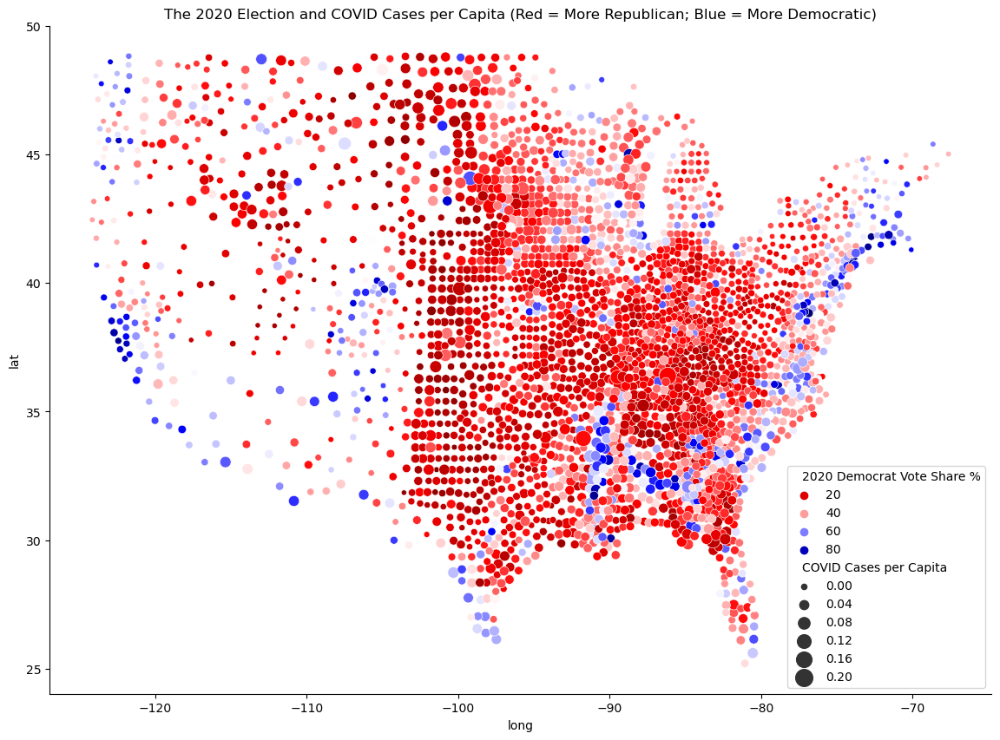

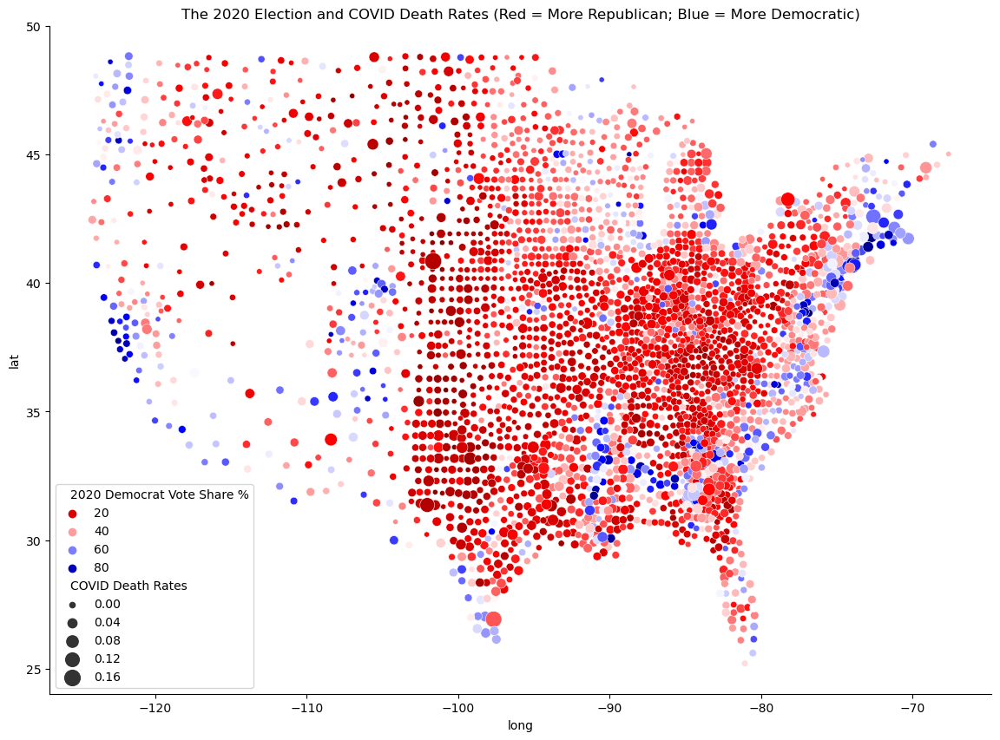

In [26]:
df_mainland = county_new[~county_new["State"].isin(["AK", "HI"])]

plt.figure(figsize = (14,10))
sns.scatterplot(data = df_mainland, x = "long", y = "lat", hue = '2020 Democrat Vote Share %', size = 'COVID Cases per Capita', 
                sizes = (20, 200), size_norm = (0, 0.20), hue_norm = (3.10,94.0), palette = "seismic_r")
plt.title("The 2020 Election and COVID Cases per Capita (Red = More Republican; Blue = More Democratic)");
sns.despine()


plt.figure(figsize = (14,10))
sns.scatterplot(data = df_mainland, x = "long", y = "lat", hue = '2020 Democrat Vote Share %', size = 'COVID Death Rates', 
                sizes = (20, 200), size_norm = (0, 0.20), hue_norm = (3.10,94.0), palette = "seismic_r")
plt.title("The 2020 Election and COVID Death Rates (Red = More Republican; Blue = More Democratic)");
sns.despine()

### Wealth

This X variable being measured is wealth or relative wealth. In terms of the metrics used based on the dataset was income, income per capita and the poverty rate. 

For the first set of graphs, income per capita was measured in relation to the COVID death rate in terms of both counties and states. This was chosen in order to assess whether the level of wealth if equally distributed had a correlation with the COVID death rate. This was to see if poorer areas suffered COVID worse perhaps due to lack of quality infrastructure.

Through analysis of the first graph it seems to not have a correlation whatsoever, in fact inserting a trendline returns a R squared value below 0.2. However looking onwards to the second graph where if we were to omit the outliers in both graphs it could be argued that there is a weak negative correlation. This would require looking at the densest area of the graph where both blue and red datapoints seem to imply that regions with a higher income fares off better with COVID.

Despite the graph's displaying weak correlation, it was important to consider this independent variable and plot these datapoints as it would allow us to understand that perhaps relative wealth doesn't affect the response to the COVID pandemic specifically as signifianctly as believed. 

In [27]:
# These graphs have a hover function

fig = px.scatter(states_only, x='Income Per Capita', y='COVID Death Rates', color='2020 Democrat Vote Share %'
                , color_continuous_scale=px.colors.sequential.Bluered_r)
fig.layout.update(title_text='Income Per Capita and COVID Death Rates for US States', title_x = 0.5
                  ,showlegend=False, plot_bgcolor = "rgba(0,0,0,0)"
                  , xaxis = dict(showgrid = True, visible = True, linecolor="black")
                  , yaxis = dict(linecolor="black", showgrid=True, visible = True, rangemode = 'tozero'))
fig.show()

fig2 = px.scatter(county_new, x='Income Per Capita', y='COVID Death Rates', color='Elected 2020'
                , color_discrete_sequence=['red','blue'])
fig2.layout.update(title_text='Income Per Capita and COVID Death Rates for US Counties <br> (Red = Republican; Blue = Democrat)', title_x = 0.5
                  ,showlegend=False, plot_bgcolor = "rgba(0,0,0,0)"
                  , xaxis = dict(showgrid = True, visible = True, linecolor="black")
                  , yaxis = dict(linecolor="black", showgrid=True, visible = True, rangemode = 'tozero'))
fig2.show()

Moving on, consideration for another metric of COVID was considered being simply the cases per capita. This was considered important to measure alongside the previously mentioned wealth metrics, overall and per capita income, as it would be necessary to gauge the impact wealth has on the virulence of COVID even if it doesn't prove to be lethal.

In this case the correlation between the variables can be considered to be relatively stronger than the previous graphs. For instance in the first graph below, omitting outliers, a negative trend is easier to observe. Additionally the second graph below with counties too shows an observable trend.

Thus, with a more general and numerous COVID metric of cases per capita it shows that income has a stronger relationship in that it be can inferred that wealthier regions benefit in a lower infection rate. Perhaps the reason for COVID lethalities showing weak correlation is due to the lack of existence of overall technology or some equivalent to combat the virus in an infected person regardless of wealth. Whereas the spread is easier to control in wealthier regions with resources.

In [28]:
# This graph has a hover function

fig = px.scatter(states_only, x='Income Per Capita', y='COVID Cases per Capita', color_discrete_sequence=['lightgrey'], text='State'
                , width = 1000, height = 800)
fig.layout.update(title_text='Income and COVID Cases per Capita for US States', title_x = 0.5,
                  showlegend=False, plot_bgcolor = "rgba(0,0,0,0)"
                  , xaxis = dict(showgrid = True, visible = True, linecolor="black", )
                  , yaxis = dict(linecolor="black", showgrid=True, visible = True))
fig.show()

In [29]:
# This graph has a hover function

fig = px.scatter(county_new, x='Income Per Capita', y='COVID Cases per Capita', color='Elected 2020', 
                 color_discrete_sequence=['red','blue']
                 , height = 800)
fig.layout.update(title_text='Income and COVID Cases per Capita for US Counties <br> (Red = Republican; Blue = Democratic)', title_x = 0.5
                  ,showlegend=False, plot_bgcolor = "rgba(0,0,0,0)"
                  , xaxis = dict(showgrid = True, visible = True, linecolor="black", rangemode = 'tozero')
                  , yaxis = dict(linecolor="black", showgrid=True, visible = True, rangemode = 'tozero'))
fig.show()

For the final metric in the wealth variable, the poverty rate was used. This was considered based on an assumption that individuals facing greater poverty would have a lack of access to resources and effective quarantine methods and thus be greater exposed to COVID. If such a relationship exists it could be useful in informing public policy to specifically target certain regions to build more effective health initiatives towards countering pandemic viruses. 

Despite this, observation of the graphs say otherwise to a correlational relationship. Inspecting counties first we see that despite increases along the poverty line, the majority of datapoints lie near the lower region of the  COVID per capita and death rate. This would suggest that poverty isn't an indicator of more lethal and infectious COVID. Moreover observing the death rate and US states where if we ignore outliers, it seems to suggest a weak to medium strengh positive correlation. This would rather imply that regions suffering from poverty have a lower chance of death per person. 

However, the poverty rate and covid per capita for US states implies a logical initial outlook in a positive correlation. This would support the assumption mentioned above in how poorer regions categorised through poverty rate would see greater virulence due to perhaps relatively worse infrastructure among other factors.

In [30]:
# These graphs have a hover function

fig = make_subplots(rows=1, cols=2, subplot_titles=("Poverty Rate and COVID Cases per Capita (US Counties)", "Poverty Rate and COVID Death Rate (US Counties)"))

fig.add_trace(go.Scatter(x =county_new['Poverty Rate'], y=county_new['COVID Cases per Capita'], mode='markers', marker = {'color': 'grey'}),row=1, col=1)


fig.add_trace(go.Scatter(x =county_new['Poverty Rate'], y=county_new['COVID Death Rates'], mode='markers', marker = {'color': 'grey'}),row=1, col=2)

fig.update_layout(height=600, width=1000, title_text="", showlegend=False, plot_bgcolor = "rgba(0,0,0,0)"
                  , xaxis = dict(showgrid = True, visible = True, linecolor="black", rangemode = 'tozero'), 
                  yaxis = dict(linecolor="black", showgrid=True, visible = True, rangemode = 'tozero')
                 ,xaxis2 = dict(showgrid = True, visible = True, linecolor="black", rangemode = 'tozero')
                  , yaxis2 = dict(linecolor="black", showgrid=True, visible = True, rangemode = 'tozero'))

fig.update_annotations(font_size=15)
#fig.update_layout(xaxis3 = dict(range=[0, 25]))
#fig.update_layout(xaxis3=dict(tickvals=[10, 20]))

fig['layout']['xaxis']['title']='Poverty Rate'
fig['layout']['xaxis2']['title']='Poverty Rate'
fig['layout']['yaxis']['title']='COVID Cases'
fig['layout']['yaxis2']['title']='COVID Deaths'
fig.show()

In [31]:
fig = make_subplots(rows=1, cols=2, subplot_titles=("Poverty Rate and COVID per Capita (US States)", "Poverty Rate and COVID Death Rate (US States)"))

fig.add_trace(go.Scatter(x =states_only['Poverty Rate'], y=states_only['COVID Cases per Capita'], mode='markers', marker = {'color': 'grey'}),row=1, col=1)

fig.add_trace(go.Scatter(x =states_only['Poverty Rate'], y=states_only['COVID Death Rates'], mode='markers', marker = {'color': 'grey'}),row=1, col=2)

fig.update_layout(height=600, width=1000, title_text="", showlegend=False, plot_bgcolor = "rgba(0,0,0,0)"
                  , xaxis = dict(showgrid = True, visible = True, linecolor="black", rangemode = 'tozero'), 
                  yaxis = dict(linecolor="black", showgrid=True, visible = True, rangemode = 'tozero')
                 , xaxis2 = dict(showgrid = True, visible = True, linecolor="black", rangemode = 'tozero'), 
                  yaxis2 = dict(linecolor="black", showgrid=True, visible = True, rangemode = 'tozero'))

fig.update_annotations(font_size=15)

fig['layout']['xaxis']['title']='Poverty Rate'
fig['layout']['xaxis2']['title']='Poverty Rate'
fig['layout']['yaxis']['title']='COVID Cases per Capita'
fig['layout']['yaxis2']['title']='COVID Death Rate'
fig.show()

### Race

Race is another X variable measured with metrics of the percentage makeup by racial group for each state. For this particular variable two other plots below with COVID deaths and cases measured for each state is to be used complementarily. The reason for this is that the collection method of the COVID and racial makeup data doesn't allow for direct comparison to one another without making too great of an extrapolation. Hence what these graphs combined together aim to do is illustrate visually the relationship of the racial makeup of each state and covid deaths and cases.

Some observations from analysing the distribution of race alongside COVID deaths is that for the peaks of the COVID death plot being the states: CT, DC, MA, NJ, NY. The second majority racial group, other than white as they are dominant across all states, is black. Except for NJ state, blacks are the third largest represented race, though this is still significant. Hence while the dominant majority being white across all states isn't particularly interesting, the observation that the blacks feature prominently in states with high deaths is. This could note that perhaps COVID is particularly more lethal towards some races. 

Another interesting observation is if we consider the COVID cases by state plot is that by taking the peaks being states: DC, FL, MA, NJ, excluding AZ and CA, we see that once again the second majority racial group are the blacks. In this case the metric being COVID cases as well indicating that a significant number of cases are highly likely to stem from the black community. As such this is highly relevant to the overall research question that looks at social welfare indicators as propogators of vulnerable indiviudals to COVID.

Race is undoubtedly an important variable as it allows us to pinpoint further beyond states and counties into collection of similar individuals. This can be critical to understanding why COVID can persist and even worsen among a certain demographic.

In [32]:
# These graphs have a hover function

fig = px.bar(states_only, x="State", y=['Hispanic','White','Black','Native','Asian','Pacific'], width=1000 , height=700)
fig.layout.update(title_text='Racial Makeup of US States', title_x = 0.5
                  ,showlegend=True, plot_bgcolor = "rgba(0,0,0,0)", legend_title=""
                  , xaxis = dict(showgrid = True, visible = True, linecolor="black", rangemode = 'tozero')
                  , yaxis = dict(linecolor="black", showgrid=True, visible = True, rangemode = 'tozero', title="Percentage"))
fig.show()


fig = px.bar(states_only, x='State', y='COVID Deaths', width=950 , height=700)
fig.layout.update(title_text='COVID Deaths in US States', title_x = 0.5
                  ,showlegend=False, plot_bgcolor = "rgba(0,0,0,0)", legend_title=""
                  , xaxis = dict(showgrid = True, visible = True, linecolor="black", rangemode = 'tozero')
                  , yaxis = dict(linecolor="black", showgrid=True, visible = True, rangemode = 'tozero'))
fig.show()

In [33]:
# This graph has a hover function
fig = px.bar(states_only, x='State', y='COVID Cases', width=950 , height=700)
fig.layout.update(title_text='COVID Cases in US States', title_x = 0.5
                  ,showlegend=False, plot_bgcolor = "rgba(0,0,0,0)", legend_title=""
                  , xaxis = dict(showgrid = True, visible = True, linecolor="black", rangemode = 'tozero')
                  , yaxis = dict(linecolor="black", showgrid=True, visible = True, rangemode = 'tozero'))
fig.show()

In [34]:
states_only_republican = states_only.query("`Elected 2020` == 'Republican'")
states_only_democrat = states_only.query("`Elected 2020` == 'Democrat'")

In [35]:
# These graphs have a hover function

fig = make_subplots(rows=3, cols=2, subplot_titles=('Asian Population in Democratic States <br>and COVID Cases per Capita', 'Asian Population in Democratic States <br>and COVID Death Rates', 'Asian Population in Republican States <br>and COVID Cases per Capita', 'Asian Population in Democratic States <br>and COVID Death Rates', 'Asian Population in Democratic States', 'Asian Population in Republican States'))

fig.add_trace(go.Scatter(x =states_only_democrat['Asian Population'], y=states_only_democrat['COVID Cases per Capita'], mode='markers', marker = {'color': 'blue'}),row=1, col=1)
fig.add_trace(go.Scatter(x =states_only_democrat['Asian Population'], y=states_only_democrat['COVID Death Rates'], mode='markers', marker = {'color': 'blue'}),row=1, col=2)


fig.add_trace(go.Scatter(x =states_only_republican['Asian Population'], y=states_only_republican['COVID Cases per Capita'], mode='markers', marker = {'color': 'red'}),row=2, col=1)
fig.add_trace(go.Scatter(x =states_only_republican['Asian Population'], y=states_only_republican['COVID Death Rates'], mode='markers', marker = {'color': 'red'}),row=2, col=2)


fig.add_trace(go.Bar(x =states_only_democrat['State'], y=states_only_democrat['Asian Population'], marker=dict(color='blue')),row=3, col=1)
fig.add_trace(go.Bar(x =states_only_republican['State'], y=states_only_republican['Asian Population'], marker=dict(color='red')),row=3, col=2)

fig.update_layout(height=1500, width=1000, title_text="", showlegend=False, plot_bgcolor = "rgba(0,0,0,0)"
                  , xaxis = dict(showgrid = True, visible = True, linecolor="black", rangemode = 'tozero'), 
                  yaxis = dict(linecolor="black", showgrid=True, visible = True, rangemode = 'tozero')
                 ,xaxis2 = dict(showgrid = True, visible = True, linecolor="black", rangemode = 'tozero')
                  , yaxis2 = dict(linecolor="black", showgrid=True, visible = True, rangemode = 'tozero')
                 ,xaxis3 = dict(showgrid = True, visible = True, linecolor="black", rangemode = 'tozero')
                  , yaxis3 = dict(linecolor="black", showgrid=True, visible = True, rangemode = 'tozero')
                 ,xaxis4 = dict(showgrid = True, visible = True, linecolor="black", rangemode = 'tozero')
                  , yaxis4 = dict(linecolor="black", showgrid=True, visible = True, rangemode = 'tozero')
                 ,xaxis5 = dict(showgrid = True, visible = True, linecolor="black", rangemode = 'tozero')
                  , yaxis5 = dict(linecolor="black", showgrid=True, visible = True, rangemode = 'tozero')
                 ,xaxis6 = dict(showgrid = True, visible = True, linecolor="black", rangemode = 'tozero')
                  , yaxis6 = dict(linecolor="black", showgrid=True, visible = True, rangemode = 'tozero')
                 ,xaxis7 = dict(showgrid = True, visible = True, linecolor="black", rangemode = 'tozero')
                  , yaxis7 = dict(linecolor="black", showgrid=True, visible = True, rangemode = 'tozero')
                 ,xaxis8 = dict(showgrid = True, visible = True, linecolor="black", rangemode = 'tozero')
                  , yaxis8 = dict(linecolor="black", showgrid=True, visible = True, rangemode = 'tozero'))

fig.update_annotations(font_size=13)
#fig.update_layout(xaxis3 = dict(range=[0, 25]))
#fig.update_layout(xaxis3=dict(tickvals=[10, 20]))

fig['layout']['xaxis']['title']='Asian Population'
fig['layout']['xaxis2']['title']='Asian Population'
fig['layout']['xaxis3']['title']='Asian Population'
fig['layout']['xaxis4']['title']='Asian Population'
fig['layout']['xaxis5']['title']='Democrat States'
fig['layout']['xaxis6']['title']='Republican States'
fig['layout']['yaxis']['title']='COVID Cases per Capita'
fig['layout']['yaxis2']['title']='COVID Death Rates'
fig['layout']['yaxis3']['title']='COVID Cases per Capita'
fig['layout']['yaxis4']['title']='COVID Death Rates'
fig['layout']['yaxis5']['title']='Asian Population'
fig['layout']['yaxis6']['title']='Asian Population'



fig.show()

In [36]:
# These graphs have a hover function

fig = make_subplots(rows=3, cols=2, subplot_titles=('Hispanic Population in Democratic States <br>and COVID Cases per Capita', 'Hispanic Population in Democratic States <br>and COVID Death Rates', 'Hispanic Population in Republican States <br>and COVID Cases per Capita', 'Hispanic Population in Republican States <br>and COVID Death Rates', 'Hispanic Population in Democratic States', 'Hispanic Population in Republican States'))

fig.add_trace(go.Scatter(x =states_only_democrat['Hispanic Population'], y=states_only_democrat['COVID Cases per Capita'], mode='markers', marker = {'color': 'blue'}),row=1, col=1)
fig.add_trace(go.Scatter(x =states_only_democrat['Hispanic Population'], y=states_only_democrat['COVID Death Rates'], mode='markers', marker = {'color': 'blue'}),row=1, col=2)


fig.add_trace(go.Scatter(x =states_only_republican['Hispanic Population'], y=states_only_republican['COVID Cases per Capita'], mode='markers', marker = {'color': 'red'}),row=2, col=1)
fig.add_trace(go.Scatter(x =states_only_republican['Hispanic Population'], y=states_only_republican['COVID Death Rates'], mode='markers', marker = {'color': 'red'}),row=2, col=2)


fig.add_trace(go.Bar(x =states_only_democrat['State'], y=states_only_democrat['Hispanic Population'], marker=dict(color='blue')),row=3, col=1)
fig.add_trace(go.Bar(x =states_only_republican['State'], y=states_only_republican['Hispanic Population'], marker=dict(color='red')),row=3, col=2)

fig.update_layout(height=1500, width=1000, title_text="", showlegend=False, plot_bgcolor = "rgba(0,0,0,0)"
                  , xaxis = dict(showgrid = True, visible = True, linecolor="black", rangemode = 'tozero'), 
                  yaxis = dict(linecolor="black", showgrid=True, visible = True, rangemode = 'tozero')
                 ,xaxis2 = dict(showgrid = True, visible = True, linecolor="black", rangemode = 'tozero')
                  , yaxis2 = dict(linecolor="black", showgrid=True, visible = True, rangemode = 'tozero')
                 ,xaxis3 = dict(showgrid = True, visible = True, linecolor="black", rangemode = 'tozero')
                  , yaxis3 = dict(linecolor="black", showgrid=True, visible = True, rangemode = 'tozero')
                 ,xaxis4 = dict(showgrid = True, visible = True, linecolor="black", rangemode = 'tozero')
                  , yaxis4 = dict(linecolor="black", showgrid=True, visible = True, rangemode = 'tozero')
                 ,xaxis5 = dict(showgrid = True, visible = True, linecolor="black", rangemode = 'tozero')
                  , yaxis5 = dict(linecolor="black", showgrid=True, visible = True, rangemode = 'tozero')
                 ,xaxis6 = dict(showgrid = True, visible = True, linecolor="black", rangemode = 'tozero')
                  , yaxis6 = dict(linecolor="black", showgrid=True, visible = True, rangemode = 'tozero')
                 ,xaxis7 = dict(showgrid = True, visible = True, linecolor="black", rangemode = 'tozero')
                  , yaxis7 = dict(linecolor="black", showgrid=True, visible = True, rangemode = 'tozero')
                 ,xaxis8 = dict(showgrid = True, visible = True, linecolor="black", rangemode = 'tozero')
                  , yaxis8 = dict(linecolor="black", showgrid=True, visible = True, rangemode = 'tozero'))

fig.update_annotations(font_size=13)
#fig.update_layout(xaxis3 = dict(range=[0, 25]))
#fig.update_layout(xaxis3=dict(tickvals=[10, 20]))

fig['layout']['xaxis']['title']='Hispanic Population'
fig['layout']['xaxis2']['title']='Hispanic Population'
fig['layout']['xaxis3']['title']='Hispanic Population'
fig['layout']['xaxis4']['title']='Hispanic Population'
fig['layout']['xaxis5']['title']='Democrat States'
fig['layout']['xaxis6']['title']='Republican States'
fig['layout']['yaxis']['title']='COVID Cases per Capita'
fig['layout']['yaxis2']['title']='COVID Death Rates'
fig['layout']['yaxis3']['title']='COVID Cases per Capita'
fig['layout']['yaxis4']['title']='COVID Death Rates'
fig['layout']['yaxis5']['title']='Hispanic Population'
fig['layout']['yaxis6']['title']='Hispanic Population'



fig.show()

In [37]:
# These graphs have a hover function

fig = make_subplots(rows=3, cols=2, subplot_titles=('White Population in Democratic States <br>and COVID Cases per Capita', 'White Population in Democratic States <br>and COVID Death Rates', 'White Population in Republican States <br>and COVID Cases per Capita', 'White Population in Republican States <br>and COVID Death Rates', 'White Population in Democratic States', 'White Population in Republican States'))

fig.add_trace(go.Scatter(x =states_only_democrat['White Population'], y=states_only_democrat['COVID Cases per Capita'], mode='markers', marker = {'color': 'blue'}),row=1, col=1)
fig.add_trace(go.Scatter(x =states_only_democrat['White Population'], y=states_only_democrat['COVID Death Rates'], mode='markers', marker = {'color': 'blue'}),row=1, col=2)


fig.add_trace(go.Scatter(x =states_only_republican['White Population'], y=states_only_republican['COVID Cases per Capita'], mode='markers', marker = {'color': 'red'}),row=2, col=1)
fig.add_trace(go.Scatter(x =states_only_republican['White Population'], y=states_only_republican['COVID Death Rates'], mode='markers', marker = {'color': 'red'}),row=2, col=2)


fig.add_trace(go.Bar(x =states_only_democrat['State'], y=states_only_democrat['White Population'], marker=dict(color='blue')),row=3, col=1)
fig.add_trace(go.Bar(x =states_only_republican['State'], y=states_only_republican['White Population'], marker=dict(color='red')),row=3, col=2)

fig.update_layout(height=1500, width=1000, title_text="", showlegend=False, plot_bgcolor = "rgba(0,0,0,0)"
                  , xaxis = dict(showgrid = True, visible = True, linecolor="black", rangemode = 'tozero'), 
                  yaxis = dict(linecolor="black", showgrid=True, visible = True, rangemode = 'tozero')
                 ,xaxis2 = dict(showgrid = True, visible = True, linecolor="black", rangemode = 'tozero')
                  , yaxis2 = dict(linecolor="black", showgrid=True, visible = True, rangemode = 'tozero')
                 ,xaxis3 = dict(showgrid = True, visible = True, linecolor="black", rangemode = 'tozero')
                  , yaxis3 = dict(linecolor="black", showgrid=True, visible = True, rangemode = 'tozero')
                 ,xaxis4 = dict(showgrid = True, visible = True, linecolor="black", rangemode = 'tozero')
                  , yaxis4 = dict(linecolor="black", showgrid=True, visible = True, rangemode = 'tozero')
                 ,xaxis5 = dict(showgrid = True, visible = True, linecolor="black", rangemode = 'tozero')
                  , yaxis5 = dict(linecolor="black", showgrid=True, visible = True, rangemode = 'tozero')
                 ,xaxis6 = dict(showgrid = True, visible = True, linecolor="black", rangemode = 'tozero')
                  , yaxis6 = dict(linecolor="black", showgrid=True, visible = True, rangemode = 'tozero')
                 ,xaxis7 = dict(showgrid = True, visible = True, linecolor="black", rangemode = 'tozero')
                  , yaxis7 = dict(linecolor="black", showgrid=True, visible = True, rangemode = 'tozero')
                 ,xaxis8 = dict(showgrid = True, visible = True, linecolor="black", rangemode = 'tozero')
                  , yaxis8 = dict(linecolor="black", showgrid=True, visible = True, rangemode = 'tozero'))

fig.update_annotations(font_size=13)
#fig.update_layout(xaxis3 = dict(range=[0, 25]))
#fig.update_layout(xaxis3=dict(tickvals=[10, 20]))

fig['layout']['xaxis']['title']='White Population'
fig['layout']['xaxis2']['title']='White Population'
fig['layout']['xaxis3']['title']='White Population'
fig['layout']['xaxis4']['title']='White Population'
fig['layout']['xaxis5']['title']='Democrat States'
fig['layout']['xaxis6']['title']='Republican States'
fig['layout']['yaxis']['title']='COVID Cases per Capita'
fig['layout']['yaxis2']['title']='COVID Death Rates'
fig['layout']['yaxis3']['title']='COVID Cases per Capita'
fig['layout']['yaxis4']['title']='COVID Death Rates'
fig['layout']['yaxis5']['title']='White Population'
fig['layout']['yaxis6']['title']='White Population'



fig.show()

In [38]:
# These graphs have a hover function

fig = make_subplots(rows=3, cols=2, subplot_titles=('Black Population in Democratic States <br>and COVID Cases per Capita', 'Black Population in Democratic States <br>and COVID Death Rates', 'Black Population in Republican States <br>and COVID Cases per Capita', 'Black Population in Republican States <br>and COVID Death Rates', 'Black Population in Democratic States', 'Black Population in Republican States'))

fig.add_trace(go.Scatter(x =states_only_democrat['Black Population'], y=states_only_democrat['COVID Cases per Capita'], mode='markers', marker = {'color': 'blue'}),row=1, col=1)
fig.add_trace(go.Scatter(x =states_only_democrat['Black Population'], y=states_only_democrat['COVID Death Rates'], mode='markers', marker = {'color': 'blue'}),row=1, col=2)


fig.add_trace(go.Scatter(x =states_only_republican['Black Population'], y=states_only_republican['COVID Cases per Capita'], mode='markers', marker = {'color': 'red'}),row=2, col=1)
fig.add_trace(go.Scatter(x =states_only_republican['Black Population'], y=states_only_republican['COVID Death Rates'], mode='markers', marker = {'color': 'red'}),row=2, col=2)


fig.add_trace(go.Bar(x =states_only_democrat['State'], y=states_only_democrat['Black Population'], marker=dict(color='blue')),row=3, col=1)
fig.add_trace(go.Bar(x =states_only_republican['State'], y=states_only_republican['Black Population'], marker=dict(color='red')),row=3, col=2)

fig.update_layout(height=1500, width=1000, title_text="", showlegend=False, plot_bgcolor = "rgba(0,0,0,0)"
                  , xaxis = dict(showgrid = True, visible = True, linecolor="black", rangemode = 'tozero'), 
                  yaxis = dict(linecolor="black", showgrid=True, visible = True, rangemode = 'tozero')
                 ,xaxis2 = dict(showgrid = True, visible = True, linecolor="black", rangemode = 'tozero')
                  , yaxis2 = dict(linecolor="black", showgrid=True, visible = True, rangemode = 'tozero')
                 ,xaxis3 = dict(showgrid = True, visible = True, linecolor="black", rangemode = 'tozero')
                  , yaxis3 = dict(linecolor="black", showgrid=True, visible = True, rangemode = 'tozero')
                 ,xaxis4 = dict(showgrid = True, visible = True, linecolor="black", rangemode = 'tozero')
                  , yaxis4 = dict(linecolor="black", showgrid=True, visible = True, rangemode = 'tozero')
                 ,xaxis5 = dict(showgrid = True, visible = True, linecolor="black", rangemode = 'tozero')
                  , yaxis5 = dict(linecolor="black", showgrid=True, visible = True, rangemode = 'tozero')
                 ,xaxis6 = dict(showgrid = True, visible = True, linecolor="black", rangemode = 'tozero')
                  , yaxis6 = dict(linecolor="black", showgrid=True, visible = True, rangemode = 'tozero')
                 ,xaxis7 = dict(showgrid = True, visible = True, linecolor="black", rangemode = 'tozero')
                  , yaxis7 = dict(linecolor="black", showgrid=True, visible = True, rangemode = 'tozero')
                 ,xaxis8 = dict(showgrid = True, visible = True, linecolor="black", rangemode = 'tozero')
                  , yaxis8 = dict(linecolor="black", showgrid=True, visible = True, rangemode = 'tozero'))

fig.update_annotations(font_size=13)
#fig.update_layout(xaxis3 = dict(range=[0, 25]))
#fig.update_layout(xaxis3=dict(tickvals=[10, 20]))

fig['layout']['xaxis']['title']='Black Population'
fig['layout']['xaxis2']['title']='Black Population'
fig['layout']['xaxis3']['title']='Black Population'
fig['layout']['xaxis4']['title']='Black Population'
fig['layout']['xaxis5']['title']='Democrat States'
fig['layout']['xaxis6']['title']='Republican States'
fig['layout']['yaxis']['title']='COVID Cases per Capita'
fig['layout']['yaxis2']['title']='COVID Death Rates'
fig['layout']['yaxis3']['title']='COVID Cases per Capita'
fig['layout']['yaxis4']['title']='COVID Death Rates'
fig['layout']['yaxis5']['title']='Black Population'
fig['layout']['yaxis6']['title']='Black Population'



fig.show()

In [39]:
# These graphs have a hover function

fig = make_subplots(rows=3, cols=2, subplot_titles=('Native Population in Democratic States <br>and COVID Cases per Capita', 'Native Population in Democratic States <br>and COVID Death Rates', 'Native Population in Republican States <br>and COVID Cases per Capita', 'Native Population in Republican States <br>and COVID Death Rates', 'Native Population in Democratic States', 'Native Population in Republican States'))

fig.add_trace(go.Scatter(x =states_only_democrat['Native Population'], y=states_only_democrat['COVID Cases per Capita'], mode='markers', marker = {'color': 'blue'}),row=1, col=1)
fig.add_trace(go.Scatter(x =states_only_democrat['Native Population'], y=states_only_democrat['COVID Death Rates'], mode='markers', marker = {'color': 'blue'}),row=1, col=2)


fig.add_trace(go.Scatter(x =states_only_republican['Native Population'], y=states_only_republican['COVID Cases per Capita'], mode='markers', marker = {'color': 'red'}),row=2, col=1)
fig.add_trace(go.Scatter(x =states_only_republican['Native Population'], y=states_only_republican['COVID Death Rates'], mode='markers', marker = {'color': 'red'}),row=2, col=2)


fig.add_trace(go.Bar(x =states_only_democrat['State'], y=states_only_democrat['Native Population'], marker=dict(color='blue')),row=3, col=1)
fig.add_trace(go.Bar(x =states_only_republican['State'], y=states_only_republican['Native Population'], marker=dict(color='red')),row=3, col=2)

fig.update_layout(height=1500, width=1000, title_text="", showlegend=False, plot_bgcolor = "rgba(0,0,0,0)"
                  , xaxis = dict(showgrid = True, visible = True, linecolor="black", rangemode = 'tozero'), 
                  yaxis = dict(linecolor="black", showgrid=True, visible = True, rangemode = 'tozero')
                 ,xaxis2 = dict(showgrid = True, visible = True, linecolor="black", rangemode = 'tozero')
                  , yaxis2 = dict(linecolor="black", showgrid=True, visible = True, rangemode = 'tozero')
                 ,xaxis3 = dict(showgrid = True, visible = True, linecolor="black", rangemode = 'tozero')
                  , yaxis3 = dict(linecolor="black", showgrid=True, visible = True, rangemode = 'tozero')
                 ,xaxis4 = dict(showgrid = True, visible = True, linecolor="black", rangemode = 'tozero')
                  , yaxis4 = dict(linecolor="black", showgrid=True, visible = True, rangemode = 'tozero')
                 ,xaxis5 = dict(showgrid = True, visible = True, linecolor="black", rangemode = 'tozero')
                  , yaxis5 = dict(linecolor="black", showgrid=True, visible = True, rangemode = 'tozero')
                 ,xaxis6 = dict(showgrid = True, visible = True, linecolor="black", rangemode = 'tozero')
                  , yaxis6 = dict(linecolor="black", showgrid=True, visible = True, rangemode = 'tozero')
                 ,xaxis7 = dict(showgrid = True, visible = True, linecolor="black", rangemode = 'tozero')
                  , yaxis7 = dict(linecolor="black", showgrid=True, visible = True, rangemode = 'tozero')
                 ,xaxis8 = dict(showgrid = True, visible = True, linecolor="black", rangemode = 'tozero')
                  , yaxis8 = dict(linecolor="black", showgrid=True, visible = True, rangemode = 'tozero'))

fig.update_annotations(font_size=13)
#fig.update_layout(xaxis3 = dict(range=[0, 25]))
#fig.update_layout(xaxis3=dict(tickvals=[10, 20]))

fig['layout']['xaxis']['title']='Native Population'
fig['layout']['xaxis2']['title']='Native Population'
fig['layout']['xaxis3']['title']='Native Population'
fig['layout']['xaxis4']['title']='Native Population'
fig['layout']['xaxis5']['title']='Democrat States'
fig['layout']['xaxis6']['title']='Republican States'
fig['layout']['yaxis']['title']='COVID Cases per Capita'
fig['layout']['yaxis2']['title']='COVID Death Rates'
fig['layout']['yaxis3']['title']='COVID Cases per Capita'
fig['layout']['yaxis4']['title']='COVID Death Rates'
fig['layout']['yaxis5']['title']='Native Population'
fig['layout']['yaxis6']['title']='Native Population'



fig.show()

In [40]:
# These graphs have a hover function

fig = make_subplots(rows=3, cols=2, subplot_titles=('Pacific Population in Democratic States <br>and COVID Cases per Capita', 'Pacific Population in Democratic States <br>and COVID Death Rates', 'Pacific Population in Republican States <br>and COVID Cases per Capita', 'Pacific Population in Republican States <br>and COVID Death Rates', 'Pacific Population in Democratic States', 'Pacific Population in Republican States'))

fig.add_trace(go.Scatter(x =states_only_democrat['Pacific Population'], y=states_only_democrat['COVID Cases per Capita'], mode='markers', marker = {'color': 'blue'}),row=1, col=1)
fig.add_trace(go.Scatter(x =states_only_democrat['Pacific Population'], y=states_only_democrat['COVID Death Rates'], mode='markers', marker = {'color': 'blue'}),row=1, col=2)


fig.add_trace(go.Scatter(x =states_only_republican['Pacific Population'], y=states_only_republican['COVID Cases per Capita'], mode='markers', marker = {'color': 'red'}),row=2, col=1)
fig.add_trace(go.Scatter(x =states_only_republican['Pacific Population'], y=states_only_republican['COVID Death Rates'], mode='markers', marker = {'color': 'red'}),row=2, col=2)


fig.add_trace(go.Bar(x =states_only_democrat['State'], y=states_only_democrat['Pacific Population'], marker=dict(color='blue')),row=3, col=1)
fig.add_trace(go.Bar(x =states_only_republican['State'], y=states_only_republican['Pacific Population'], marker=dict(color='red')),row=3, col=2)

fig.update_layout(height=1500, width=1000, title_text="", showlegend=False, plot_bgcolor = "rgba(0,0,0,0)"
                  , xaxis = dict(showgrid = True, visible = True, linecolor="black", rangemode = 'tozero'), 
                  yaxis = dict(linecolor="black", showgrid=True, visible = True, rangemode = 'tozero')
                 ,xaxis2 = dict(showgrid = True, visible = True, linecolor="black", rangemode = 'tozero')
                  , yaxis2 = dict(linecolor="black", showgrid=True, visible = True, rangemode = 'tozero')
                 ,xaxis3 = dict(showgrid = True, visible = True, linecolor="black", rangemode = 'tozero')
                  , yaxis3 = dict(linecolor="black", showgrid=True, visible = True, rangemode = 'tozero')
                 ,xaxis4 = dict(showgrid = True, visible = True, linecolor="black", rangemode = 'tozero')
                  , yaxis4 = dict(linecolor="black", showgrid=True, visible = True, rangemode = 'tozero')
                 ,xaxis5 = dict(showgrid = True, visible = True, linecolor="black", rangemode = 'tozero')
                  , yaxis5 = dict(linecolor="black", showgrid=True, visible = True, rangemode = 'tozero')
                 ,xaxis6 = dict(showgrid = True, visible = True, linecolor="black", rangemode = 'tozero')
                  , yaxis6 = dict(linecolor="black", showgrid=True, visible = True, rangemode = 'tozero')
                 ,xaxis7 = dict(showgrid = True, visible = True, linecolor="black", rangemode = 'tozero')
                  , yaxis7 = dict(linecolor="black", showgrid=True, visible = True, rangemode = 'tozero')
                 ,xaxis8 = dict(showgrid = True, visible = True, linecolor="black", rangemode = 'tozero')
                  , yaxis8 = dict(linecolor="black", showgrid=True, visible = True, rangemode = 'tozero'))

fig.update_annotations(font_size=13)
#fig.update_layout(xaxis3 = dict(range=[0, 25]))
#fig.update_layout(xaxis3=dict(tickvals=[10, 20]))

fig['layout']['xaxis']['title']='Pacific Population'
fig['layout']['xaxis2']['title']='Pacific Population'
fig['layout']['xaxis3']['title']='Pacific Population'
fig['layout']['xaxis4']['title']='Pacific Population'
fig['layout']['xaxis5']['title']='Democrat States'
fig['layout']['xaxis6']['title']='Republican States'
fig['layout']['yaxis']['title']='COVID Cases per Capita'
fig['layout']['yaxis2']['title']='COVID Death Rates'
fig['layout']['yaxis3']['title']='COVID Cases per Capita'
fig['layout']['yaxis4']['title']='COVID Death Rates'
fig['layout']['yaxis5']['title']='Pacific Population'
fig['layout']['yaxis6']['title']='Pacific Population'



fig.show()

### Employment Type

Employment was chosen as a variable specifically the different types of jobs. This was selected as the nature and environment of different jobs can have an impact on how easily COVID is transmitted amongst like workers and hence it would be important to understand the distribution of it. 

An observable trend is that based on the type of work there is a trend as to the working populations distribution and the COVID cases recorded. The below table is color coded in a way that it highlights the vertical shape of each specification of employment. This plot can perhaps allude to a a possible increase in transmission rate to workers in an industry that is farther from the origin on the x axis. Furthermore the plot also reveals the higher number of cases in certain states such as CA, DC, and AZ. 

In relation to the research question, the type of employment based on the proportion of the population working in it can reveal the risk of certain jobs to COVID due to factors like the particular work environment.

In [41]:
# This graph has a hover function

fig = px.scatter(states_only, x=['% in Family Work', '% in Self Employed','% in Construction','% in Production Work','% in Public Work','% in Service Work', '% in Office Work', '% in Professional Work','% in Private Work'], y='COVID Cases', hover_data=["State"], color_discrete_sequence=['red','grey','blue','black','red','grey','blue','black','red'])
fig.layout.update(title_text='% of Workforce in Employment Types and COVID Cases (US States)', title_x = 0.5
                  ,showlegend=True, plot_bgcolor = "light grey", legend_title=""
                  , xaxis = dict(showgrid = True, visible = True, linecolor="black", rangemode = 'tozero', title="% of Workforce",showspikes = True,spikemode  = 'across',spikesnap = 'cursor',showline=True, spikecolor='red')
                  , yaxis = dict(linecolor="black", showgrid=True, visible = True, rangemode = 'tozero'))

fig.show()

### Employment Level

In [42]:
# This graph has a hover function

fig = px.scatter(county_new, x='Unemployment Rate', y='COVID Cases per Capita', color='Elected 2020', 
                 color_discrete_sequence=['red','blue']
                 , height = 800, hover_name="County", hover_data=["State"], trendline="ols")
fig.layout.update(title_text='Unemployment Rate and COVID Cases per Capita for US Counties <br> (Red = Republican; Blue = Democratic)', title_x = 0.5
                  ,showlegend=False, plot_bgcolor = "rgba(0,0,0,0)"
                  , xaxis = dict(showgrid = True, visible = True, linecolor="black", rangemode = 'tozero')
                  , yaxis = dict(linecolor="black", showgrid=True, visible = True, rangemode = 'tozero'))
fig.show()

This variable was chosen as unemployment is a significant indicator of welfare due to the lack of appropriate resources that can hinder quality and healthy life. As such plotting it against COVID cases per capita was done in order to assess whether a county with greater unemployment would see an induced number of vulnerable persons to contracting COVID especially when access to healthcare and perhaps social distancing methods may not be available. In democratic counties colored blue, a weak positive correlation is suggested, whereas in republican counties in red seem to have a very poor to zero correlation. Thus, it does seem to be that unemployment isn't perhaps a defining variable in how virulent COVID can be in certain counties.

# Project 2

## The Message

How well-off a person is, is derived from a range of different factors from personal choices, biological and environmental factors as well as relative affluence. In this case, being well-off is how endogenous factors can determine whether an individual will experience greater risk or security from COVID. While it is difficult to analyse these factors individually and come to a well-informed inference that certain welfare metrics point towards either risk or aversion, collectively there are indicators that a better well-off person is less susceptible to COVID.

Across the different welfare metrics utilised to explore their significance in influencing the severity of COVID, 5 distinct metrics were analysed being: Political Affiliation, Wealth, Race, Employment Type, and Employment Level. On this we considered COVID from different perspectives in terms of severity, one being the virulence and the other it's lethality. As such we group the severity of COVID into these two respective groups.

**Virulence**
- Aggregate Number of COVID Cases
- Infection Rate

**Lethality**
- Aggregate Number of COVID induced Deaths 
- Mortality Rate due to COVID induced Fatalities

While greater virulence is important by itself, what is of greater significance is whether a person with exposure in a more virulent COVID environment can have lower lethality than those with lower virulence. This would suggest that resources and infrastructure in place are of high quality and of importance in recovery. Additionally context to geographic location can be an explanation as to initial virulence.

Consider the **virulence** of COVID through: Aggregate Number of COVID Cases and Infection Rate.
In this, grouping by states will be done in order to signify that the right to political freedom does in fact relate to COVID severity. In addition the states have been **ordered in ascending order by poverty rate**.

From an analysis of the first set of graphs that consider the virulence of COVID it could be argued that in Democratic leaning states as poverty rate increases we see a weak positive correlation in an increase with COVID cases. On the other hand Republican states seem to peak in the middle of the distribution of the poverty rate. Thus, what could be gathered is that if we assume where states with greater poverty have a lack of resources then Democrat states with greater poverty face perhaps poor effective resource management in comparison to Republican states. 

To infer whether an individual suffering from poverty in a Democrat state has a greater risk of contracting COVID, the infection rate should be considered. Observing the second set of graphs in general Democrat states do have higher peaks. However, further analysis in terms of population densities for these states should be considered as knowing the voting trend of Democrat states they tend to occupy more urbanized and hence denser populatuon areas that can contribute to greater virulence.

In [43]:
states_republican = states_only.query("`Elected 2020` == 'Republican'")
states_democrat = states_only.query("`Elected 2020` == 'Democrat'")
states_democrat = states_democrat.sort_values('Poverty Rate')
states_republican = states_republican.sort_values('Poverty Rate')

In [44]:
# These graphs have a hover function

fig = make_subplots(rows=2, cols=2, subplot_titles=('Democratic States <br>and Aggregate Number of COVID Cases', 'Republican States <br>and Aggregate Number of COVID Cases', 'Democrat States <br>and COVID Infection Rate', 'Republican States <br>and COVID Infection Rates'))

fig.add_trace(go.Bar(x =states_democrat['State'], y=states_democrat['COVID Cases'], marker=dict(color='blue')),row=1, col=1)
fig.add_trace(go.Bar(x =states_democrat['State'], y=states_democrat['COVID Cases per Capita'], marker=dict(color='blue')),row=2, col=1)


fig.add_trace(go.Bar(x =states_republican['State'], y=states_republican['COVID Cases'], marker=dict(color='red')),row=1, col=2)
fig.add_trace(go.Bar(x =states_republican['State'], y=states_republican['COVID Cases per Capita'], marker=dict(color='red')),row=2, col=2)

fig.update_layout(height=1200, width=1000, title_text="", showlegend=False, plot_bgcolor = "rgba(0,0,0,0)"
                  , xaxis = dict(showgrid = True, visible = True, linecolor="black", rangemode = 'tozero'), 
                  yaxis = dict(linecolor="black", showgrid=True, visible = True, rangemode = 'tozero')
                 ,xaxis2 = dict(showgrid = True, visible = True, linecolor="black", rangemode = 'tozero')
                  , yaxis2 = dict(linecolor="black", showgrid=True, visible = True, rangemode = 'tozero')
                 ,xaxis3 = dict(showgrid = True, visible = True, linecolor="black", rangemode = 'tozero')
                  , yaxis3 = dict(linecolor="black", showgrid=True, visible = True, rangemode = 'tozero')
                 ,xaxis4 = dict(showgrid = True, visible = True, linecolor="black", rangemode = 'tozero')
                  , yaxis4 = dict(linecolor="black", showgrid=True, visible = True, rangemode = 'tozero'))

fig.update_annotations(font_size=13)
#fig.update_layout(xaxis3 = dict(range=[0, 25]))
#fig.update_layout(xaxis3=dict(tickvals=[10, 20]))

fig['layout']['xaxis']['title']='State'
fig['layout']['xaxis2']['title']='State'
fig['layout']['xaxis3']['title']='State'
fig['layout']['xaxis4']['title']='State'
fig['layout']['yaxis']['title']='Aggregate Number of COVID Cases'
fig['layout']['yaxis2']['title']='Aggregate Number of COVID Cases'
fig['layout']['yaxis3']['title']='Infection Rate'
fig['layout']['yaxis4']['title']='Infection Rate'

fig.show()

Despite, virulence being more prelavent in Democratic states, lethality can be a more defining metric in order to assess whether political choice has an impact on COVID severity. On inspection, aggregate deaths peak roughly in the middle of states ordered by ascending poverty. Yet, looking at the peaks there are two Republican states in contrast to one Democratic state. In addition understanding the context of the states, Florida and Texas (Republican) and New York (Democrat), where both are large in terms of population, New York can be argued to be more of an urbanised region with a greater global presence. This argument considers that as a global destination for trade and leisure, the number of human traffic would outweigh Florida and Texas despite them also having large populations. As such, it is not illogical to see New York as a state with a high number of deaths.

Furthermore, analysing the mortality rate, Democrat states have a more negative movement towards the higher spectrum of the poverty rate whereas Republican ones are more positively trending. Hence, while in the short-term, Democrat states see some positively corelation between virulence and increasing poverty, in the long-run with mortality it says otherwise. As such, it could be extrapolated in that treatment once infected and COVID recovery may be more effective perhaps due to better policy setting and adherence in Democratic states over Republican.

In [45]:
# These graphs have a hover function

fig = make_subplots(rows=2, cols=2, subplot_titles=('Democratic States <br>and Aggregate Number of COVID induced Deaths', 'Republican States <br>and Aggregate Number of COVID induced Deaths', 'Democrat States <br>and Mortality Rate due to COVID induced Fatalities', 'Republican States <br>and Mortality Rate due to COVID induced Fatalities'))

fig.add_trace(go.Bar(x =states_democrat['State'], y=states_democrat['COVID Deaths'], marker=dict(color='blue')),row=1, col=1)
fig.add_trace(go.Bar(x =states_democrat['State'], y=states_democrat['COVID Death Rates'], marker=dict(color='blue')),row=2, col=1)


fig.add_trace(go.Bar(x =states_republican['State'], y=states_republican['COVID Deaths'], marker=dict(color='red')),row=1, col=2)
fig.add_trace(go.Bar(x =states_republican['State'], y=states_republican['COVID Death Rates'], marker=dict(color='red')),row=2, col=2)

fig.update_layout(height=1200, width=1000, title_text="", showlegend=False, plot_bgcolor = "rgba(0,0,0,0)"
                  , xaxis = dict(showgrid = True, visible = True, linecolor="black", rangemode = 'tozero'), 
                  yaxis = dict(linecolor="black", showgrid=True, visible = True, rangemode = 'tozero')
                 ,xaxis2 = dict(showgrid = True, visible = True, linecolor="black", rangemode = 'tozero')
                  , yaxis2 = dict(linecolor="black", showgrid=True, visible = True, rangemode = 'tozero')
                 ,xaxis3 = dict(showgrid = True, visible = True, linecolor="black", rangemode = 'tozero')
                  , yaxis3 = dict(linecolor="black", showgrid=True, visible = True, rangemode = 'tozero')
                 ,xaxis4 = dict(showgrid = True, visible = True, linecolor="black", rangemode = 'tozero')
                  , yaxis4 = dict(linecolor="black", showgrid=True, visible = True, rangemode = 'tozero'))

fig.update_annotations(font_size=13)
#fig.update_layout(xaxis3 = dict(range=[0, 25]))
#fig.update_layout(xaxis3=dict(tickvals=[10, 20]))

fig['layout']['xaxis']['title']='State'
fig['layout']['xaxis2']['title']='State'
fig['layout']['xaxis3']['title']='State'
fig['layout']['xaxis4']['title']='State'
fig['layout']['yaxis']['title']='Aggregate Number of COVID induced Deaths'
fig['layout']['yaxis2']['title']='Aggregate Number of COVID induced Deaths'
fig['layout']['yaxis3']['title']='Mortality Rate due to COVID induced Fatalities'
fig['layout']['yaxis4']['title']='Mortality Rate due to COVID induced Fatalities'

fig.show()

## Importing and merging with US State and County files for 2016 and 2020

In [46]:
state_df_2016 = gpd.read_file("http://www2.census.gov/geo/tiger/GENZ2016/shp/cb_2016_us_state_5m.zip")
state_df_2020 = gpd.read_file("https://www2.census.gov/geo/tiger/GENZ2020/shp/cb_2020_us_state_5m.zip")
county_df_2016 = gpd.read_file("http://www2.census.gov/geo/tiger/GENZ2016/shp/cb_2016_us_county_5m.zip")
county_df_2020 = gpd.read_file("https://www2.census.gov/geo/tiger/GENZ2020/shp/cb_2020_us_county_5m.zip")
country_df_2020 = gpd.read_file("https://www2.census.gov/geo/tiger/GENZ2020/shp/cb_2020_us_nation_5m.zip")

We will have 2 levels for the map, one with the all counties and another only with the boundary of the states. Firstly starting with states we merge it with shape files. Since we only want to use the geodata from the imported files, there is no further need to merge any longitude or latitude for the states geodataframe.

In [47]:
states_only_2 = states_only.copy()
#map2_Cali.drop(columns=['lat', 'long'])
map_US_states = state_df_2020.merge(states_only_2, left_on="STUSPS", right_on="State", how="inner")
map_US_states.drop_duplicates(subset='State', inplace=True)
no_hawaii_states = map_US_states.drop(labels=[36], axis=0)

Now the counties dataframe is merged with the county shape files in order to be able to create the polygonal or geometry county shapes.

In [48]:
map1 = county_new.copy()
map1.insert(loc = 4,
          column = 'Coordinates',
          value = list(zip(map1.long, map1.lat)))
map1["Coordinates"] = map1["Coordinates"].apply(Point)
map_points = gpd.GeoDataFrame(map1, geometry="Coordinates")
#map_county
map_county = county_df_2020.merge(map_points, left_on="NAME", right_on="County", how="inner")

However, for the county level we want to convert the dataframe into a geodataframe in order to create boundaries of each of the counties. We want to drop any Hawaii or Alaska counties to make the map sizing better.

In [49]:
no_hawaii_alaska_counties = map_county[(map_county.STUSPS != 'HI') & (map_county.STUSPS != 'AK') & (map_county.STUSPS != 'PR') & (map_county.STUSPS != 'VI')]

Below a check was made to make sure that all the latitude datapoints are floats, this is to ensure that all counties amd states have coordinates that can be used.

In [50]:
print((no_hawaii_alaska_counties['lat'].map(type) == float).unique()) # checks if all latitude datapoints are floats
print((no_hawaii_alaska_counties['long'].map(type) == float).unique()) # checks if all longitude datapoints are floats

print((no_hawaii_states['lat'].map(type) == float).unique()) # checks if all latitude datapoints are floats
print((no_hawaii_states['long'].map(type) == float).unique()) # checks if all longitude datapoints are floats

[ True]
[ True]
[ True]
[ True]


This geodataframe requires removing columns that have properties that may clash with other columns as it will raise errors when converting it into a GeoJSON coordinates for bokeh.

In [51]:
#list(no_hawaii_alaska_counties.columns)
no_hawaii_alaska_counties_bokeh = no_hawaii_alaska_counties.copy()
no_hawaii_alaska_counties_bokeh = no_hawaii_alaska_counties_bokeh.drop('Coordinates', axis = 1)
#list(no_hawaii_alaska_counties_bokeh.columns)
no_hawaii_alaska_counties_bokeh.drop_duplicates(subset='AFFGEOID', inplace=True)
no_hawaii_alaska_counties_bokeh.dropna(inplace=True, axis=0)

## Maps

In [52]:
from bokeh.io import output_notebook
from bokeh.plotting import figure, ColumnDataSource
from bokeh.io import output_notebook, show, output_file
from bokeh.plotting import figure
from bokeh.models import GeoJSONDataSource, LinearColorMapper, ColorBar, HoverTool
from bokeh.palettes import brewer
from bokeh.layouts import row, column
output_notebook()
import json

Loading BokehJS ...

In [53]:
# Reversed the RdBu[10] color map manually
RdBu_r = ('#67001f', '#b2182b','#d6604d', '#f4a582', '#fddbc7', '#d1e5f0', '#92c5de', '#4393c3', '#2166ac', '#053061')
RdBu_r_simple = ('#b2182b','#d6604d', '#f4a582', '#92c5de', '#4393c3', '#2166ac')

Initially the parition of the contiguous US is based on States. This was done in order to use the dataframe constructed focused on US states in order for an aggregate outlook through US states on welfare metrics and COVID. Moreover, counties was not focused on as based on the methodogology that the states dataframe was derived from the counties, it is visually easier to grasp trends while not losing any accuracy.

This is the code for the 2020 US Presidential Election Results (State) in a bokeh map form.

In [54]:
wi_geojson2=GeoJSONDataSource(geojson=no_hawaii_states.to_json())

color_mapper = LinearColorMapper(palette = RdBu_r, low = 0, high = 100)
color_bar = ColorBar(color_mapper=color_mapper, label_standoff=8,width = 500, height = 20,
                     border_line_color=None,location = (0,0), orientation = 'horizontal')
hover = HoverTool(tooltips = [ ('State','@NAME'), ('Democrat %','@{2020 Democrat Vote Share %}'),
                             ('Republican %', '@{2020 Republican Vote Share %}')])
color_bar = ColorBar(color_mapper = color_mapper,
                     label_standoff = 12,
                     location = (0,0),
                     title = 'Voting Trend (Red = More Republican; Blue = More Democratic)')
vote_state_2020 = figure(title="2020 US Presidential Election Results (State)", tools=[hover])
vote_state_2020.title.align = "center"
vote_state_2020.title.text_font_size = "30px"
vote_state_2020.patches("xs","ys",source=wi_geojson2,
          fill_color = {'field' :'2020 Democrat Vote Share %', 'transform' : color_mapper})
vote_state_2020.add_layout(color_bar, 'below')
vote_state_2020.plot_height=800
vote_state_2020.plot_width=1000

This is the code for the US Covid Cases (State) in a bokeh map form.

In [55]:
wi_geojson2=GeoJSONDataSource(geojson=no_hawaii_states.to_json())

Reds_r = ('#fcbba1', '#fc9272', '#fb6a4a', '#ef3b2c','#cb181d','#a50f15','#67000d')

color_mapper = LinearColorMapper(palette = Reds_r, low = 0, high = 100000)
color_bar = ColorBar(color_mapper=color_mapper, label_standoff=8,width = 500, height = 20,
                     border_line_color=None,location = (0,0), orientation = 'horizontal')
hover = HoverTool(tooltips = [ ('State','@NAME'), ('COVID Cases','@{COVID Cases}')])
color_bar = ColorBar(color_mapper = color_mapper,
                     label_standoff = 12,
                     location = (0,0),
                     title = 'Darker = More Cases; Lighter = Less Cases')
covid_cases_state = figure(title="US Covid Cases (State)", tools=[hover])
covid_cases_state.title.align = "center"
covid_cases_state.title.text_font_size = "30px"
covid_cases_state.patches("xs","ys",source=wi_geojson2,
          fill_color = {'field' :'COVID Cases', 'transform' : color_mapper})
covid_cases_state.add_layout(color_bar, 'below')
covid_cases_state.plot_height=800
covid_cases_state.plot_width=1000

This is the code for the US Covid Cases per Capita (State) in a bokeh map form.

In [56]:
wi_geojson2=GeoJSONDataSource(geojson=no_hawaii_states.to_json())

Reds_r = ('#fcbba1', '#fc9272', '#fb6a4a', '#ef3b2c','#cb181d','#a50f15','#67000d')

color_mapper = LinearColorMapper(palette = Reds_r, low = 0, high = 0.06)
color_bar = ColorBar(color_mapper=color_mapper, label_standoff=8,width = 500, height = 20,
                     border_line_color=None,location = (0,0), orientation = 'horizontal')
hover = HoverTool(tooltips = [ ('State','@NAME'), ('COVID Cases per Capita','@{COVID Cases per Capita}{0.0000}')])
color_bar = ColorBar(color_mapper = color_mapper,
                     label_standoff = 12,
                     location = (0,0),
                     title = 'Darker = More Cases per Capita; Lighter = Less Cases per Capita')
covid_cases_state_per_cap = figure(title="US Covid Cases per Capita (State)", tools=[hover])
covid_cases_state_per_cap.title.align = "center"
covid_cases_state_per_cap.title.text_font_size = "30px"
covid_cases_state_per_cap.patches("xs","ys",source=wi_geojson2,
          fill_color = {'field' :'COVID Cases per Capita', 'transform' : color_mapper})
covid_cases_state_per_cap.add_layout(color_bar, 'below')
covid_cases_state_per_cap.plot_height=800
covid_cases_state_per_cap.plot_width=1000

This is the code for the US Covid Deaths (State) in a bokeh map form.

In [57]:
wi_geojson2=GeoJSONDataSource(geojson=no_hawaii_states.to_json())

Reds_r = ('#fcbba1', '#fc9272', '#fb6a4a', '#ef3b2c','#cb181d','#a50f15','#67000d')

color_mapper = LinearColorMapper(palette = Reds_r, low = 0, high = 35000)
color_bar = ColorBar(color_mapper=color_mapper, label_standoff=8,width = 500, height = 20,
                     border_line_color=None,location = (0,0), orientation = 'horizontal')
hover = HoverTool(tooltips = [ ('State','@NAME'), ('COVID Deaths','@{COVID Deaths}')])
color_bar = ColorBar(color_mapper = color_mapper,
                     label_standoff = 12,
                     location = (0,0),
                     title = 'Darker = More Deaths; Lighter = Less Deaths')
covid_deaths = figure(title="US Covid Deaths (State)", tools=[hover])
covid_deaths.title.align = "center"
covid_deaths.title.text_font_size = "30px"
covid_deaths.patches("xs","ys",source=wi_geojson2,
          fill_color = {'field' :'COVID Deaths', 'transform' : color_mapper})
covid_deaths.add_layout(color_bar, 'below')
covid_deaths.plot_height=800
covid_deaths.plot_width=1000

This is the code for the US Covid Death Rates (State) in a bokeh map form.

In [58]:
wi_geojson2=GeoJSONDataSource(geojson=no_hawaii_states.to_json())

Reds_r = ('#fcbba1', '#fc9272', '#fb6a4a', '#ef3b2c','#cb181d','#a50f15','#67000d')

color_mapper = LinearColorMapper(palette = Reds_r, low = 0, high = 0.002)
color_bar = ColorBar(color_mapper=color_mapper, label_standoff=8,width = 500, height = 20,
                     border_line_color=None,location = (0,0), orientation = 'horizontal')
hover = HoverTool(tooltips = [ ('State','@NAME'), ('COVID Death Rates','@{COVID Death Rates}{0.000000}')])
color_bar = ColorBar(color_mapper = color_mapper,
                     label_standoff = 12,
                     location = (0,0),
                     title = 'Darker = Higher Death Rates; Lighter = Lower Death Rates')
US_covid_death_rates = figure(title="US Covid Death Rates (State)", tools=[hover])
US_covid_death_rates.title.align = "center"
US_covid_death_rates.title.text_font_size = "30px"
US_covid_death_rates.patches("xs","ys",source=wi_geojson2,
          fill_color = {'field' :'COVID Death Rates', 'transform' : color_mapper})
US_covid_death_rates.add_layout(color_bar, 'below')
US_covid_death_rates.plot_height=800
US_covid_death_rates.plot_width=1000

Comparisons between COVID statistics will be made with voting results of the 2020 US elections (State Level). The reasons for selecting this variable specifically is due to investigating whether personal beliefs and in turn political stances on COVID policy has an impact on the transmission and lethality of COVID. This is informed by the variation in how stringent COVID minimising policies were implemented that followed a general trend that Democrats had a greater cautionary attitude towards COVID. Moreover, based on previous plots, political affiliation seems to reflect the strongest potential correlation with COVID severity, though this paper treats political affiliation as a fundamental basis of welfare. Thus, by mapping this we can observe any geographic trends that may arise.

These comparisons will be done one by one:

1) **Election Results and COVID Cases:**
2) **Election Results and COVID Cases per Capita:**
3) **Election Results and Covid Deaths:**
4) **Election Results and Covid Death Rates:**


**1) Election Results and COVID Cases:**
From an inital outlook we observe that the mid-North, South and East of the US suffered the greatest in terms of aggregate number. And in the overwhelmingly Republican central US, the aggregate numbers were significant, whereas it is clearer that while many Democratic states had high cases, in general Republican states fared off much worse. Relating back to the scope of the paper, it does illustrate to a degree that Republican voters may suffer off worse.

In [59]:
# hover function is available
show(column(vote_state_2020, covid_cases_state))

**2) Election Results and COVID Cases per Capita:**
Inspecting virulence rate, the trend seems to hold that Republican held states fare off worse and in this regard the virulence rate is informative in considering the context Democratic states are much denser in population. Thus, the connection to assessing welfare in terms of political choice shows that an individual would fare off worse due to perhaps a weaker public health system that allows greater transmission despite lessor burden on the system such as undersupply (due to assuming lower population density).

In [60]:
show(column(covid_cases_state_per_cap))

**3) Election Results and Covid Deaths:**
In a previous graphical analysis, it was deduced that Democratic states had initial higher deaths due to the geographic location and in turn trade and mass human movement that stems from that. Now, the geographical importance is highlighted in that aggregate deaths were relatively high only on the coast or border of the US in contrast to more central states. The importance of this in investigating correlation of welfare and COVID severity is that the overwhelmingly Democratic states, in exception of Texas and some northern states, are on the boundaries of the US and that they occupy lessor remote areas. This informs us for example in one case is that recent immigrants who most likely will settle in these areas can be at a greater risk.

In [61]:
show(column(covid_deaths))

**4) Election Results and Covid Death Rates:**
The final map comparison is in investigating election choice and its influence in welfare and COVID mortality rates. Unsurprisingly, based on previous assumptions while we saw that states like California had high deaths, when accounting for population, smaller population wise states ike Arizona saw greater lethality. It is interesting to note that New York with the worst mortality rate is Democratic despite the inferences made. This can be considered a possible outlier for Democratic states in terms of welfare as New York's results negates the pattern identified. In final it can be derived that a tendency for Republican states to have worse mortality rates that as mentioned could be down to poor public health strategies, infrastructure or combinations of other factors. 

In [62]:
show(US_covid_death_rates)

### Merging with a new dataset

Hypothesis: Perhaps neighborhoods with greater police presence that can be quantified by an analysis of statistics like estimated average arrests per year sees a lower severity of COVID. This could make logical sense as such neighborhoods under greater surveillance may have to implement precautionary COVID measures more stringently. In addition areas with higher crime may see higher quality emergency and health facilities that in context of the COVID pandemic can facilitate and easing of COVID severity.

A new dataset introduced consists of statistics on criminal activity. This was chosen as we consider better welfare to be in regions of diminished criminal activity. Moreover, an assumption was made that more criminal prone areas may see a lower government expenditure either aggregately or per capita on public services. This is an important assumption as provision of basic necessary services are a given for good welfare. Hence, specific statistics observed will be:

- Murder Rate
- Violent Crime Rate
- Estimated Average Arrests

These were selected to consider for capita specific in order to observe with population in mind allowing for more accurate inferences to be made. In addition no aggregate measures were given.

In [63]:
raw_new_dataset = pd.read_csv(r'/Users/adieaimannazrinnoornazri/ECO225/Project Data/deaths_arrests.csv')

In [64]:
edited_new_dataset = raw_new_dataset[['State', 'City','Murder Rate', 'Violent Crime Rate', 'Estimated Average Arrests per Year']].copy()
edited_new_dataset['Estimated Average Arrests per Year'] = pd.to_numeric(edited_new_dataset['Estimated Average Arrests per Year'], errors='coerce')
edited_new_dataset = edited_new_dataset.replace(np.nan, 0, regex=True)
#edited_new_dataset.dropna(inplace=True, axis=0)
#edited_new_dataset
edited_new_dataset2 = edited_new_dataset.groupby('State').mean().apply(list).reset_index()

In [65]:
map_county_with_crime = no_hawaii_states.merge(edited_new_dataset2, left_on="NAME", right_on="State", how="left")
map_county_with_crime.drop('State_y', axis = 1, inplace=True)
#map_county_with_crime
#map_county_with_crime.keys()

In [66]:
wi_geojson2=GeoJSONDataSource(geojson=map_county_with_crime.to_json())

Reds_r = ('#fcbba1', '#fc9272', '#fb6a4a', '#ef3b2c','#cb181d','#a50f15','#67000d')

color_mapper = LinearColorMapper(palette = Reds_r, low = 0, high = 110000)
color_bar = ColorBar(color_mapper=color_mapper, label_standoff=8,width = 500, height = 20,
                     border_line_color=None,location = (0,0), orientation = 'horizontal')
hover = HoverTool(tooltips = [ ('State','@NAME'), ('Estimated Average Arrests per Year','@{Estimated Average Arrests per Year}{[0]0000}')])
color_bar = ColorBar(color_mapper = color_mapper,
                     label_standoff = 12,
                     location = (0,0),
                     title = 'Darker = More Cases; Lighter = Less Cases; Grey = No Data')
estimated_arrests_state = figure(title="Estimated Average Arrests per Year (State)", tools=[hover])
estimated_arrests_state.title.align = "center"
estimated_arrests_state.title.text_font_size = "30px"
estimated_arrests_state.patches("xs","ys",source=wi_geojson2,
          fill_color = {'field' :'Estimated Average Arrests per Year', 'transform' : color_mapper})
estimated_arrests_state.add_layout(color_bar, 'below')
estimated_arrests_state.plot_height=800
estimated_arrests_state.plot_width=1000

In [67]:
wi_geojson2=GeoJSONDataSource(geojson=map_county_with_crime.to_json())

Reds_r = ('#fcbba1', '#fc9272', '#fb6a4a', '#ef3b2c','#cb181d','#a50f15','#67000d')

color_mapper = LinearColorMapper(palette = Reds_r, low = 3.6, high = 19)
color_bar = ColorBar(color_mapper=color_mapper, label_standoff=8,width = 500, height = 20,
                     border_line_color=None,location = (0,0), orientation = 'horizontal')
hover = HoverTool(tooltips = [ ('State','@NAME'), ('Violent Crime Rate','@{Violent Crime Rate}{[0]0.000}')])
color_bar = ColorBar(color_mapper = color_mapper,
                     label_standoff = 12,
                     location = (0,0),
                     title = 'Darker = More Cases; Lighter = Less Cases; Grey = No Data')
violent_rate_state = figure(title="Violent Crime Rate (State)", tools=[hover])
violent_rate_state.title.align = "center"
violent_rate_state.title.text_font_size = "30px"
violent_rate_state.patches("xs","ys",source=wi_geojson2,
          fill_color = {'field' :'Violent Crime Rate', 'transform' : color_mapper})
violent_rate_state.add_layout(color_bar, 'below')
violent_rate_state.plot_height=800
violent_rate_state.plot_width=1000

In [68]:
wi_geojson2=GeoJSONDataSource(geojson=map_county_with_crime.to_json())

Reds_r = ('#fcbba1', '#fc9272', '#fb6a4a', '#ef3b2c','#cb181d','#a50f15','#67000d')

color_mapper = LinearColorMapper(palette = Reds_r, low = 2, high = 60)
color_bar = ColorBar(color_mapper=color_mapper, label_standoff=8,width = 500, height = 20,
                     border_line_color=None,location = (0,0), orientation = 'horizontal')
hover = HoverTool(tooltips = [ ('State','@NAME'), ('Murder Rate','@{Murder Rate}{[0]0.000}')])
color_bar = ColorBar(color_mapper = color_mapper,
                     label_standoff = 12,
                     location = (0,0),
                     title = 'Darker = More Cases; Lighter = Less Cases; Grey = No Data')
murder_rate_state = figure(title="Murder Rate (State)", tools=[hover])
murder_rate_state.title.align = "center"
murder_rate_state.title.text_font_size = "30px"
murder_rate_state.patches("xs","ys",source=wi_geojson2,
          fill_color = {'field' :'Murder Rate', 'transform' : color_mapper})
murder_rate_state.add_layout(color_bar, 'below')
murder_rate_state.plot_height=800
murder_rate_state.plot_width=1000

For all the crime statistics chosen, only the COVID cases per capita and death rates were considered for a comparison in order to explore any potential correlations. This was done as only calculated data over raw data was available for crime statistics. 

Graph comparisons are of the following pairs:

- US COVID Cases per Capita versus Estimated Average Arrests per Year
- US COVID Death Rates versus Murder Rate
- US COVID Death Rates versus violent crime rate

These are to be observed together as comparing they are segmented based on lethality. For example, cases per capita should be higher than death rates which is the same cases for estimated arrests over murder or violent crime rates.

**1) US COVID Cases per Capita and Estimated Average Arrests per Year:**
Observing the graphs synchonously in general estimated arrests lie quite low in terms of the range. Thus, the extremes that are the states, New York, Illinois, Tennessee, and Pennsylvania, will be analysed alongside their COVID cases per capita. This is logical to do since if they all indicate high cases per capita then it can be presumed that areas with higher crime (regardless of severity) which in turn is a probable factor welfare will allow the proliferation of COVID. Three of the extreme estimated average arrests states, New York, Illinois, and Tennessee score highly in COVID cases per capita. While in this regard they are not the highest per capita states, some positive correlation is suggested, however due to Pennsylvania having a relatively lower COVID cases per capita. Additional factors must be considered beyond a simple relationship between higher general crime and cases per capita to allow a informed inference on COVID severity. Nevertheless, some implied relationship warrants further exploration into the prevalence of crime as an indicator despite the counteracting of the hypotheis it may be instead that crime is an indicator of poor welfare (in terms of government services) and thus highly susceptibile to biological viruses like COVID.

In [69]:
show(column(covid_cases_state_per_cap, estimated_arrests_state))

**2) US COVID Death Rates versus Violent Crime Rate:**
Violent crime was considered as a variable to be measured against US COVID death rates as it could be considered that states with crimes that have a high probability in lethality may 
By considering the states with the highest violent crime rates and then contrasting with their own COVID death rates we identify the following states: Michigan, Missouri, Tennessee, Alabama, and Maryland. Respectively each states death rates are to the lower spectrum of COVID death rates. As such if we now consider states with the lowest violent crime rates and again contrasting with COVID death rates, the following states are: Oregon, Arizona, Nebraska, and Virginia. And respectively the only state scoring fairly high in COVID death rates is Arizona. Hence, this suggests there may be some truth to the hypothesis in that these areas may see better treatment of COVID due to perhaps prelavence of services equipped with dealing with continuous intense trauma and conditions on a daily basis. Yet, as Arizona did score highly in COVID death rates the relationship must be further explored.  

In [70]:
show(column(US_covid_death_rates, violent_rate_state))

**3) US COVID Death Rates versus murder crime rate:**
This metric was selected as it can be directly compared to COVID death rates in that both imply mortality and hence any correlation can be deduced as an indicator on whether areas with higher crime may have factors that would see a relativly lower COVID death rate. This can be due to the assumption that these areas may have better equipped medical facilities. Analysing the higher murder rate states that are: Washington, Louisiana, Michigan and Maryland, when comparing to COVID death rates, Louisiana has very high relative death rates, though Washington and Maryland are not far off. Thus, this does not necessarily fit the proposed hypothesis. 

In [71]:
show(column(murder_rate_state))

# Project 3

figure out how to use the app token so that I don't have throttling limits

saved urls I'm using for this 

https://dev.socrata.com/foundry/data.cdc.gov/8xkx-amqh
https://data.cdc.gov/profile/edit/developer_settings  (has the app token)

CDC main datasets:
- https://data.cdc.gov/Vaccinations/COVID-19-Vaccinations-in-the-United-States-County/8xkx-amqh

CDC other secondary datasets:
- https://data.cdc.gov/Vaccinations/Vaccines-gov-COVID-19-vaccinating-provider-locatio/5jp2-pgaw <-- Working with this
- https://data.cdc.gov/Vaccinations/COVID-19-Vaccination-Demographics-in-the-United-St/km4m-vcsb

JHU datasets:
- https://coronavirus.jhu.edu/vaccines/us-states


In [74]:
from sodapy import Socrata

client = Socrata("data.cdc.gov", None)

results = client.get("8xkx-amqh", limit = 2000)

results_df = pd.DataFrame.from_records(results)
results_df

,date,fips,mmwr_week,recip_county,recip_state,completeness_pct,administered_dose1_recip,administered_dose1_pop_pct,administered_dose1_recip_5plus,administered_dose1_recip_5pluspop_pct,...,census2019_18pluspop,census2019_65pluspop,bivalent_booster_5plus,bivalent_booster_5plus_pop_pct,bivalent_booster_12plus,bivalent_booster_12plus_pop_pct,bivalent_booster_18plus,bivalent_booster_18plus_pop_pct,bivalent_booster_65plus,bivalent_booster_65plus_pop_pct
0,2023-03-15T00:00:00.000,29227,11,Worth County,MO,91.3,990,49.2,990,51.8,...,1619,522,200,10.5,200,11.4,199,12.3,141,27
1,2023-03-15T00:00:00.000,01131,11,Wilcox County,AL,92.6,7168,69.1,7162,73.7,...,7954,2105,624,6.4,624,7.1,620,7.8,380,18.1
2,2023-03-15T00:00:00.000,48373,11,Polk County,TX,98.9,31761,61.8,31731,65.2,...,41147,9733,5422,11.1,5392,12.1,5347,13,3475,35.7
3,2023-03-15T00:00:00.000,28017,11,Chickasaw County,MS,98.1,9644,56.4,9640,60.6,...,12839,3001,826,5.2,824,5.8,814,6.3,489,16.3
4,2023-03-15T00:00:00.000,46077,11,Kingsbury County,SD,96.7,4455,90.2,4446,95,...,3778,1160,1010,22,1000,24.2,984,26,670,57.8
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1995,2023-03-15T00:00:00.000,16015,11,Boise County,ID,97.7,3245,41.4,3237,42.9,...,6551,2058,779,10.3,776,10.9,769,11.7,516,25.1
1996,2023-03-15T00:00:00.000,13087,11,Decatur County,GA,88.8,15499,58.7,15487,63,...,19996,4397,1499,6.1,1492,6.7,1473,7.4,851,19.4
1997,2023-03-15T00:00:00.000,05061,11,Howard County,AR,92.1,8860,67.1,8860,72.2,...,9749,2386,812,6.6,809,7.4,802,8.2,534,22.4
1998,2023-03-15T00:00:00.000,22067,11,Morehouse Parish,LA,96.9,13735,55.2,13725,59.2,...,18848,4814,1312,5.7,1307,6.3,1292,6.9,826,17.2


# Conclusion

The observed variables and their correlation on COVID results varied significantly. For political affiliation, suggestions of a positive trend were evident when comparing across different COVID results such as per capita versus total. When looking at geographic distribution and vote swings, correlation is evident albeit weakly. 

Income showed weak to no correlation even across per capita and total COVID results and across counties and state level. Employment level only saw weak correlation in poverty rate and covid per capita on the state level. 

Race however showed promise specifically in a trend of states with high Black populations and high covid levels. 

Employment type showed promise when interpreting the results based on the weightage of the employment type on the population and how it can lead to greater COVID severity, though this too needs to be further analysed. Finally, employment level was considered though weak positive correlation was only suggested when data was seperated into Democratic and Republican, though with only Democratic showing some correlation. 

Geographic plotting observing where majority Republican and Democratic states resided had promise with fairly good correlation, though this was made on assumptions that must be explored further to strengthen any initial observed correlation. Analysis of crime statistics showed some correlation based on the hypothesis proposed being that higher crime areas may have better medical facilities and perhaps more stringent policing. Where in turn may see greater treatment and recovery from infected persons as well as better adherence to social distancing policies. While estimated arrest and violent crime rate fit with the hypothesis fairly strong, murder rate suggested an opposite correlation. Further Analysis with additional data such as healthcare and police expenditure may be required to identify the significance of crime as a influencing welfare metric on COVID severity.

Next steps are to consider analysing the independent variables with the strongest correlation with COVID severity with weaker independent variables. This can allow for inferences to be made into determining how welfare is shaped by a range of factors and then perhaps investigate a quantitative way to identify good versus poor welfare. Importing further datasets such as vaccination statistics will also be considered. Statistical weighting will also be refined in order to reach more conclusive results. Finally, further geographical tools will be explored to identify further probable reasons as to the distribution of COVID severity. 

# Works Cited

OECD. “GDP as a Welfare Metric: The beyond Gdp Agenda.” Understanding National Accounts, 2014, 451–77. https://doi.org/10.1787/9789264214637-16-en. 

Razieh, Cameron, Francesco Zaccardi, Nazrul Islam, Clare L Gillies, Yogini V. Chudasama, Alex Rowlands, David E      Kloecker, Melanie J Davies, Kamlesh Khunti, and Thomas Yates. “Ethnic Minorities and Covid-19: Examining Whether Excess Risk Is Mediated through Deprivation.” European Journal of Public Health 31, no. 3 (2021): 630–34. https://doi.org/10.1093/eurpub/ckab041. 

Vogliano, Maxwell. “Rethinking Welfare Metrics: Beyond Aggregative and Composite Indicators to a Dashboard Approach,” 2022.  